In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import plotly
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta
from scipy.optimize import curve_fit
from scipy.ndimage import uniform_filter1d, gaussian_filter1d
from scipy import stats
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from statsmodels.tsa.seasonal import seasonal_decompose
from fbprophet import Prophet

# The final approximation function is here
from Approximation_func import time_series_approximation
from Supporting_inform_funcs import metrics_calc

from jupyterthemes import jtplot
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)

import plotly.io as pio
pio.templates.default = "plotly_dark"

In [2]:
data_total = pd.read_excel('./Потребление_газа.xlsx', header=0)
data_total['Дни'] = (data_total['Дата'] - data_total['Дата'].iloc[0]).dt.days
data_total['Добыча_NET'] = data_total['Добыча'] - data_total['Расходы_на_нужды']
data_total['Месторождение'] = 'ЕСГ'
data_total.head()

,Дата,Газпром,Остальные,Казах_газ,Газ_стабилизации,Добыча,ПОТРЕБЛЕНИЕ_ЕСГ_РФ,ПОТРЕБЛЕНИЕ_ЕСГ_вне_РФ,Закачка_в_ПХГ,Отбор_из_ПХГ,Изменение_по_ЕСГ,Расходы_на_нужды,Дни,Добыча_NET,Месторождение
0,2015-09-01,912.3,407.1,80.5,3.9,1403.8,593.9,505.1,220.5,0.0,0.0,84.3,0,1319.5,ЕСГ
1,2015-09-02,933.0,404.4,73.2,3.9,1414.5,603.2,508.8,210.1,0.0,0.0,92.4,1,1322.1,ЕСГ
2,2015-09-03,942.0,405.5,69.2,4.2,1420.9,608.7,510.0,208.4,0.1,0.0,93.9,2,1327.0,ЕСГ
3,2015-09-04,939.7,406.3,67.0,4.4,1417.4,606.5,512.9,209.0,0.0,0.0,89.0,3,1328.4,ЕСГ
4,2015-09-05,943.3,400.7,63.6,4.4,1412.0,588.0,518.1,202.1,0.0,0.0,103.8,4,1308.2,ЕСГ


In [9]:
consumption = pd.read_csv('21_24.csv', sep=';')
consumption['date'] = pd.to_datetime(consumption['date'], format='%d.%m.%Y')
consumption.head(3)

,date,upper,p99,p95,p90,lower,mean
0,2021-09-01,723.137984,674.496560,660.125230,652.165724,545.567381,623.855259
1,2021-09-02,729.284467,676.345008,661.780877,653.689694,546.292038,625.476139
2,2021-09-03,781.977796,706.405917,685.056014,673.533844,500.056507,629.807377


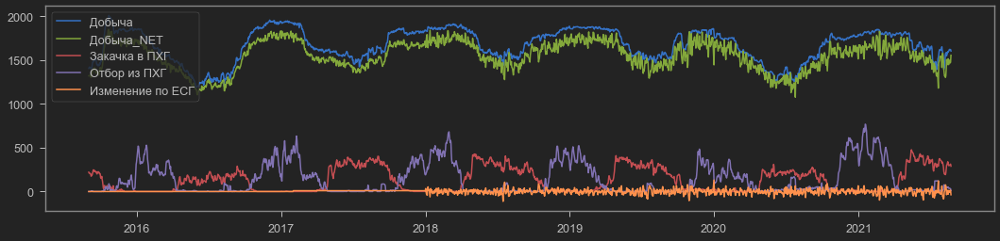

In [10]:
plt.figure(figsize=(18, 4))
plt.plot(data_total['Дата'], data_total['Добыча'], label='Добыча')
plt.plot(data_total['Дата'], data_total['Добыча_NET'], label='Добыча_NET')
plt.plot(data_total['Дата'], data_total['Закачка_в_ПХГ'], label='Закачка в ПХГ')
plt.plot(data_total['Дата'], data_total['Отбор_из_ПХГ'], label='Отбор из ПХГ')
plt.plot(data_total['Дата'], data_total['Изменение_по_ЕСГ'], label='Изменение по ЕСГ')
plt.legend(loc=2)
plt.show()

************************************************************************************************************************
The field "ЕСГ"
Change points: [2012.1 2014.4 2015. ]
Fourier function of 8-th order
R2=0.883; MAE=43.82 (mean_y=1551.61); RMSE=55.86


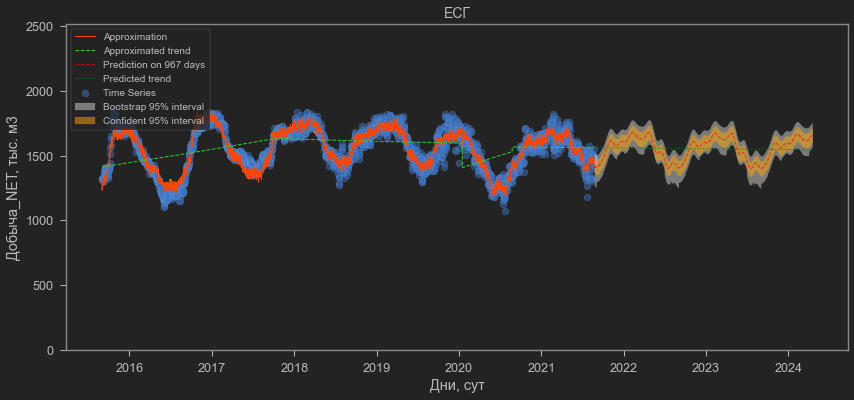

************************************************************************************************************************
The field "ЕСГ"
Change points: [2015.]
Fourier function of 8-th order
R2=0.693; MAE=80.84 (mean_y=1672.04); RMSE=100.91


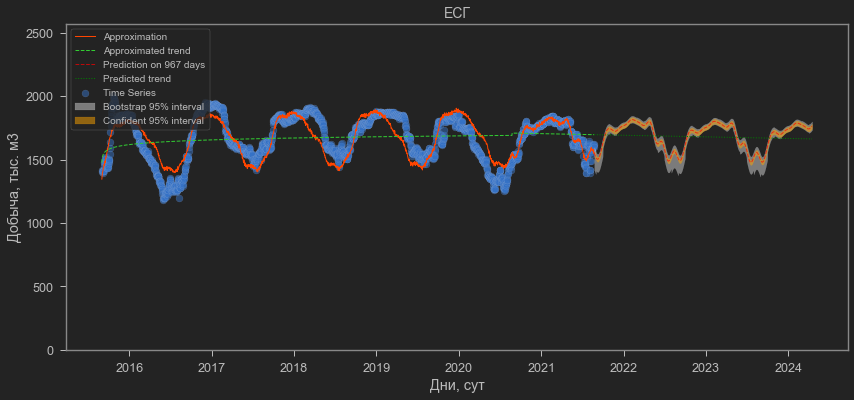

In [3]:
exceptions = {'change_points': {'ЕСГ': [1820]}}
# exceptions = {}
prediction = int(2.65*365)
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)
total_result = time_series_approximation(data_total, 'ЕСГ', target_col='Добыча_NET', fourier_order=8, noise_alpha=0.05, noise_window=5, prediction=prediction, exceptions=exceptions)
total_result_ini = time_series_approximation(data_total, 'ЕСГ', target_col='Добыча', fourier_order=8, noise_alpha=0.05, noise_window=5, prediction=prediction, exceptions=exceptions)

************************************************************************************************************************
The field "ЕСГ"
Change points: [2011.7]
Fourier function of 8-th order
R2=0.892; MAE=28.59 (mean_y=127.64); RMSE=44.0


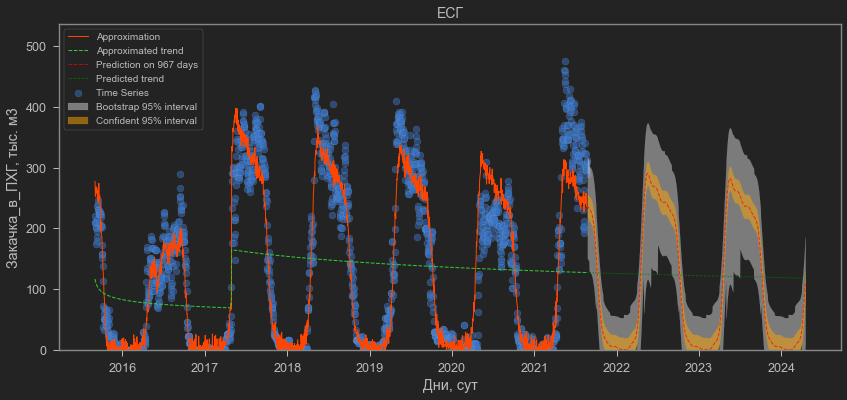

In [4]:
exceptions = {}
UGS_in = time_series_approximation(data_total, 'ЕСГ', target_col='Закачка_в_ПХГ', fourier_order=8, noise_alpha=0.05, noise_window=5, prediction=prediction, exceptions=exceptions)

************************************************************************************************************************
The field "ЕСГ"
Change points: [2011.6]
Fourier function of 8-th order
R2=0.805; MAE=49.06 (mean_y=138.82); RMSE=76.17


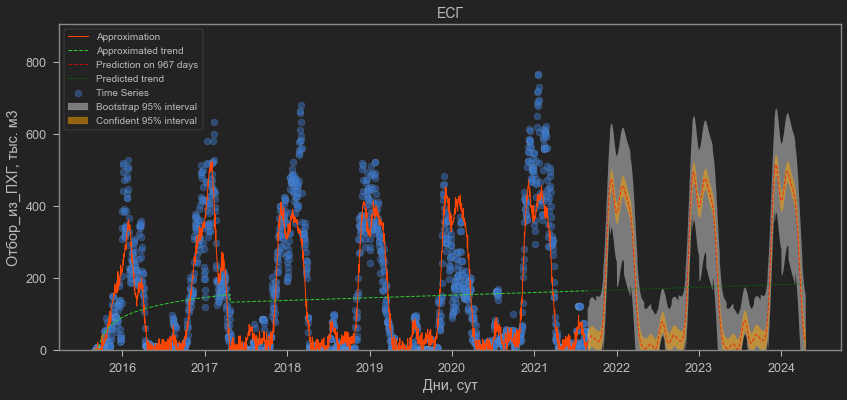

In [5]:
exceptions = {'change_points': {'ЕСГ': [600]}}
UGS_out = time_series_approximation(data_total, 'ЕСГ', target_col='Отбор_из_ПХГ', fourier_order=8, noise_alpha=0.05, noise_window=5, prediction=prediction, exceptions=exceptions)

************************************************************************************************************************
The field "ЕСГ"
Change points: [2011.6]
Fourier function of 8-th order
R2=0.67; MAE=34.17 (mean_y=609.26); RMSE=45.95


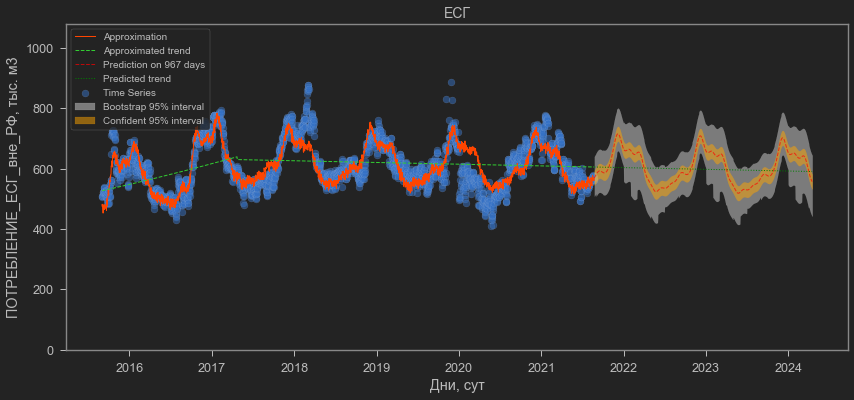

In [6]:
cons_abroad = time_series_approximation(data_total, 'ЕСГ', target_col='ПОТРЕБЛЕНИЕ_ЕСГ_вне_РФ', fourier_order=8, noise_alpha=0.05, noise_window=5, prediction=prediction, exceptions=exceptions)

In [7]:
consumption = pd.read_csv('21_24.csv', sep=';')
consumption['date'] = pd.to_datetime(consumption['date'], format='%d.%m.%Y')
consumption = pd.merge(consumption, cons_abroad[['Дата', 
                                                 'Approximation',
                                                 'Bootstrap_quantile_0.025',
                                                 'Bootstrap_quantile_0.975']].rename(columns={'Approximation': 'Approximation_cons', 
                                                                                               'Bootstrap_quantile_0.025': 'Bootstrap_quantile_0.025_cons',
                                                                                               'Bootstrap_quantile_0.975': 'Bootstrap_quantile_0.975_cons'}), 
                       how='left', left_on='date', right_on='Дата').drop(columns='Дата')

consumption = pd.merge(consumption, total_result[['Дата', 
                                                  'Approximation', 
                                                  'Bootstrap_quantile_0.025',
                                                  'Bootstrap_quantile_0.975']].rename(columns={'Approximation': 'Approximation_prod', 
                                                                                               'Bootstrap_quantile_0.025': 'Bootstrap_quantile_0.025_prod',
                                                                                               'Bootstrap_quantile_0.975': 'Bootstrap_quantile_0.975_prod'}), 
                       how='left', left_on='date', right_on='Дата').drop(columns='Дата')
consumption['UGS'] = consumption['Approximation_prod'] - (consumption['mean'] + consumption['Approximation_cons'])
consumption['UGS_in'] = consumption.loc[consumption['UGS']>0, 'UGS']
consumption['UGS_out'] = consumption.loc[consumption['UGS']<0, 'UGS'].abs()
consumption.fillna(0, inplace=True)

      Production   Cons_RF  Cons_Abroad  UGS_out   UGS_in
date                                                     
2022    567979.6  353672.1     219202.4  56328.8  51433.8
2023    565896.7  354188.0     217133.6  56603.9  51179.0



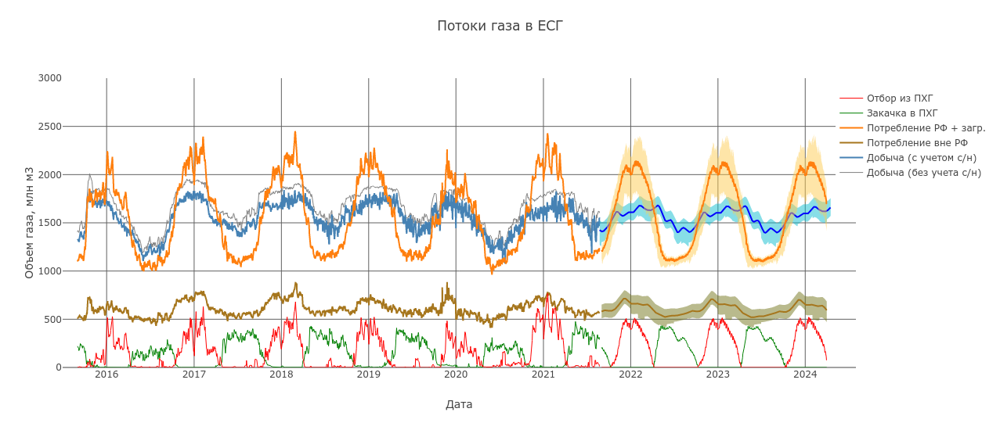

In [8]:
pio.templates.default = "none"

fig = go.Figure()
# Исходный ряд
fig.add_trace(go.Scatter(x=data_total['Дата'], 
                         y=data_total['Добыча'],
                         mode='lines', name='Добыча (без учета с/н)',
                         line=dict(color='grey', width=1)
                        ),
             )

fig.add_trace(go.Scatter(x=data_total['Дата'], 
                         y=data_total['Добыча_NET'],
                         mode='lines', name='Добыча (с учетом с/н)',
                         line=dict(color='steelblue')
                        ),
             )

fig.add_trace(go.Scatter(x=data_total['Дата'], 
                         y=data_total['ПОТРЕБЛЕНИЕ_ЕСГ_вне_РФ'],
                         mode='lines', name='Потребление вне РФ',
                         line=dict(color='rgb(166, 118, 29)'),
                         fill='none',
                         stackgroup='one',
                        ),
             )

fig.add_trace(go.Scatter(x=data_total['Дата'], 
                         y=data_total['ПОТРЕБЛЕНИЕ_ЕСГ_РФ'],
                         mode='lines', name='Потребление РФ + загр.',
                         line=dict(color='#FF7F0E'),
                         fill='none',
                         stackgroup='one'
                        ),
             )

fig.add_trace(go.Scatter(x=data_total['Дата'], 
                         y=data_total['Закачка_в_ПХГ'],
                         mode='lines', name='Закачка в ПХГ',
                         line=dict(color='green', 
                                   width=1)
                        ),
             )
fig.add_trace(go.Scatter(x=data_total['Дата'], 
                         y=data_total['Отбор_из_ПХГ'],
                         mode='lines', name='Отбор из ПХГ',
                         line=dict(color='red',
                                   width=1)
                        ),
             )


# fig.add_trace(go.Scatter(x=data_total['Дата'], 
#                          y=data_total['Добыча_NET'],
#                          mode='markers', name='Добыча-с/н',
#                          marker=dict(color='steelblue',
#                                      opacity=0.5,
#                                      size=3,
#                                      line=dict(color='#C9FBE5',
#                                                width=0.5
#                                               )
#                                     )
#                         ),
#              )

# fig.add_trace(go.Scatter(x=data_total['Дата'], 
#                          y=data_total['ПОТРЕБЛЕНИЕ_ЕСГ'],
#                          mode='markers', name='Потребление РФ',
#                          marker=dict(color='#FF7F0E',
#                                      opacity=0.5,
#                                      size=3,
#                                      line=dict(color='#B6E880',
#                                                width=0.5
#                                               )
#                                     )
#                         ),
#              )

# Аппроксимация
fig.add_trace(go.Scatter(x=total_result['Дата'][-prediction:], 
                         y=total_result['Approximation'][-prediction:] + total_result['Bootstrap_quantile_0.975'][-prediction:],
                         mode='lines', name='Top (95%)',
                         line=dict(color='#10BECF', width=0),
                         fill=None,
                         showlegend=False,
                        ),
             )
fig.add_trace(go.Scatter(x=total_result['Дата'][-prediction:], 
                         y=total_result['Approximation'][-prediction:] + total_result['Bootstrap_quantile_0.025'][-prediction:],
                         mode='lines', name='Bot (95%)',
                         line=dict(color='#10BECF', width=0),
                         fill='tonexty',
                         showlegend=False,
                        ),
             )
fig.add_trace(go.Scatter(x=total_result['Дата'][-prediction:], 
                         y=total_result['Approximation'][-prediction:],
                         mode='lines', name='Добыча',
#                          line=dict(color='cyan'),
                         line=dict(color='blue'),
                         showlegend=False,
                        ),
             )

# Потребеление
fig.add_trace(go.Scatter(x=consumption['date'], 
                         y=consumption['p95'] + consumption['Approximation_cons'],
                         mode='lines', name='Top (95%)',
#                          line=dict(color='yellow', width=0),
                         line=dict(color='#FECB52', width=0),
                         fill=None,
                         showlegend=False,
                        ),
             )
fig.add_trace(go.Scatter(x=consumption['date'], 
                         y=consumption['lower'] + consumption['Approximation_cons'],
                         mode='lines', name='Bot (95%)',
#                          line=dict(color='yellow', width=0),
                         line=dict(color='#FECB52', width=0),
                         fill='tonexty',
                         showlegend=False,
                        ),
             )

fig.add_trace(go.Scatter(x=consumption['date'], 
                         y=consumption['Approximation_cons'] + consumption['Bootstrap_quantile_0.975_cons'],
                         mode='lines', name='Top (95%)',
                         line=dict(color='rgb(116, 118, 29)', width=0),
                         fill=None,
                         showlegend=False,
                        ),
             )
fig.add_trace(go.Scatter(x=consumption['date'], 
                         y=consumption['Approximation_cons'] + consumption['Bootstrap_quantile_0.025_cons'],
                         mode='lines', name='Bot (95%)',
                         line=dict(color='rgb(116, 118, 29)', width=0),
                         fill='tonexty',
                         showlegend=False,
                        ),
             )

fig.add_trace(go.Scatter(x=consumption['date'], 
                         y=consumption['Approximation_cons'],
                         mode='lines', name='Потребление вне РФ',
                         line=dict(color='rgb(166, 118, 29)'),
                         showlegend=False,
                         stackgroup='two',
                         fill='none',
                        ),
             )
fig.add_trace(go.Scatter(x=consumption['date'], 
                         y=consumption['mean'],
                         mode='lines', name='Потребление РФ ',
                         line=dict(color='#FF7F0E'),
                         showlegend=False,
                         stackgroup='two',
                         fill='none',
                        ),
             )


# ПХГ
fig.add_trace(go.Scatter(x=consumption['date'], 
                         y=consumption['UGS_in'],
                         mode='lines', name='Закачка в ПХГ',
                         showlegend=False,
                         line=dict(color='green', 
                                   width=1)
                        ),
             )
fig.add_trace(go.Scatter(x=consumption['date'], 
                         y=consumption['UGS_out'],
                         mode='lines', name='Отбор из ПХГ',
                         showlegend=False,
                         line=dict(color='red',
                                   width=1)
                        ),
             )


# fig.layout.plot_bgcolor = '#252525'
fig.layout.xaxis.gridcolor = '#606060'
fig.update_xaxes(range=[datetime.strptime('01-07-2015', '%d-%m-%Y'), datetime.strptime('31-07-2024', '%d-%m-%Y')])
fig.update_xaxes(title_text='Дата')
fig.layout.yaxis.gridcolor = '#606060'
fig.update_yaxes(range=[0, 3000])
fig.update_yaxes(title_text='Объем газа, млн м3')
fig.update_layout(autosize=False,
                  width=1500,
                  height=550,
                  legend_orientation="h",
                  hovermode = "x",
                  legend=dict(x=.5, xanchor="center"),
#                   margin=dict(l=0, r=0, t=0, b=0),
                  title={'text': "Потоки газа в ЕСГ",
                         'y':0.95,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'}
                 )
# fig.update_layout(
#     xaxis=dict(
#         rangeselector=dict(
#             buttons=list([
#                 dict(count=3,
#                      label="3 года",
#                      step="year",
#                      stepmode="backward"),
#                 dict(count=5,
#                      label="5 лет",
#                      step="year",
#                      stepmode="backward"),
#                 dict(label="Весь период", step="all")
#             ]),
#             bgcolor='grey',
#         ),
#         rangeslider=dict(
#             visible=True
#         ),
#         type="date"
#     )
# )
fig.update_layout(
    legend=dict(
    orientation='v',
    yanchor="top",
    y=0.97,
    xanchor="right",
    x=1.17,
))

print(consumption.groupby(consumption['date'].dt.year).agg(Production=('Approximation_prod', np.sum),
                                                           Cons_RF=('mean', np.sum),
                                                           Cons_Abroad=('Approximation_cons', np.sum),
                                                           UGS_out=('UGS_out', np.sum),
                                                           UGS_in=('UGS_in', np.sum)
                                                          ).round(1).iloc[1:3])
print()
fig

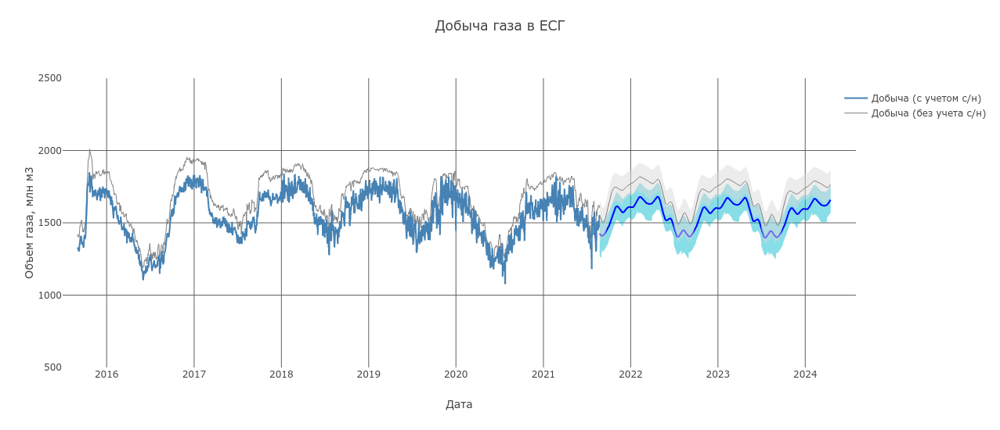

In [9]:
pio.templates.default = "none"

fig = go.Figure()
# Исходный ряд
fig.add_trace(go.Scatter(x=data_total['Дата'], 
                         y=data_total['Добыча'],
                         mode='lines', name='Добыча (без учета с/н)',
                         line=dict(color='grey', width=1)
                        ),
             )

fig.add_trace(go.Scatter(x=data_total['Дата'], 
                         y=data_total['Добыча_NET'],
                         mode='lines', name='Добыча (с учетом с/н)',
                         line=dict(color='steelblue')
                        ),
             )


# Аппроксимация
fig.add_trace(go.Scatter(x=total_result['Дата'][-prediction:], 
                         y=total_result['Approximation'][-prediction:] + total_result['Bootstrap_quantile_0.975'][-prediction:],
                         mode='lines', name='Top (95%)',
                         line=dict(color='#10BECF', width=0),
                         fill=None,
                         showlegend=False,
                        ),
             )
fig.add_trace(go.Scatter(x=total_result['Дата'][-prediction:], 
                         y=total_result['Approximation'][-prediction:] + total_result['Bootstrap_quantile_0.025'][-prediction:],
                         mode='lines', name='Bot (95%)',
                         line=dict(color='#10BECF', width=0),
                         fill='tonexty',
                         showlegend=False,
                        ),
             )
fig.add_trace(go.Scatter(x=total_result['Дата'][-prediction:], 
                         y=total_result['Approximation'][-prediction:],
                         mode='lines', name='Добыча',
#                          line=dict(color='cyan'),
                         line=dict(color='blue'),
                         showlegend=False,
                        ),
             )


fig.add_trace(go.Scatter(x=total_result_ini['Дата'][-prediction:], 
                         y=total_result_ini['Approximation'][-prediction:] + total_result['Bootstrap_quantile_0.975'][-prediction:],
                         mode='lines', name='Top (95%)',
                         line=dict(color='rgb(217, 217, 217)', width=0),
                         fill=None,
                         showlegend=False,
                        ),
             )
fig.add_trace(go.Scatter(x=total_result_ini['Дата'][-prediction:], 
                         y=total_result_ini['Approximation'][-prediction:] + total_result['Bootstrap_quantile_0.025'][-prediction:],
                         mode='lines', name='Bot (95%)',
                         line=dict(color='rgb(217, 217, 217)', width=0),
                         fill='tonexty',
                         showlegend=False,
                        ),
             )
fig.add_trace(go.Scatter(x=total_result_ini['Дата'][-prediction:], 
                         y=total_result_ini['Approximation'][-prediction:],
                         mode='lines', name='Добыча',
#                          line=dict(color='cyan'),
                         line=dict(color='grey', width=1),
                         showlegend=False,
                        ),
             )

fig.layout.xaxis.gridcolor = '#606060'
fig.update_xaxes(range=[datetime.strptime('01-07-2015', '%d-%m-%Y'), datetime.strptime('31-07-2024', '%d-%m-%Y')])
fig.update_xaxes(title_text='Дата')
fig.layout.yaxis.gridcolor = '#606060'
fig.update_yaxes(range=[500, 2500])
fig.update_yaxes(title_text='Объем газа, млн м3')
fig.update_layout(autosize=False,
                  width=1500,
                  height=550,
                  legend_orientation="h",
                  hovermode = "x",
                  legend=dict(x=.5, xanchor="center"),
                  title={'text': "Добыча газа в ЕСГ",
                         'y':0.95,
                         'x':0.5,
                         'xanchor': 'center',
                         'yanchor': 'top'}
                 )

fig.update_layout(
    legend=dict(
    orientation='v',
    yanchor="top",
    y=0.97,
    xanchor="right",
    x=1.17,
))

print()
fig

In [4]:
df['Месторождение'].unique()

array(['Заполярное', 'Ямбургское', 'Бованенковское', 'Медвежье (сеном)',
       'УКПГ-НТС', 'УКПГ-Ныда', 'Харасавэйское', 'Юбилейное (сеном)',
       'Ямсовейское', 'Вынгапуровское', 'Вынгаяхинское', 'Еты-Пуровское',
       'Зап.Таркосалинск.', 'Комсомольское', 'Астраханское ГКМ',
       'Болтное', 'Казанское', 'Мирное', 'Мыльджинское', 'Останинское',
       'Пинджинское', 'Рыбальное', 'Северо-Васюганское',
       'Северо-Останинское', 'Ен.-Яхинское (В.)',
       'Ен.-Яхинское (ГПН-Зап)', 'НГДУ (валанжин)', 'НГДУ (попутныйгаз)',
       'Песцовое', 'Песцовое (ГПН-Зап)', 'УКПГ-22 (Ачимовка)',
       'УКПГ-31 (Ачимгаз)', 'УКПГ-41 (АчимДевелопмент)',
       'УКПГ-51 (АчимДевелопмент)', 'Уренгойское', 'Губкинское (сеном)',
       'Южно-Русское НГКМ', 'Оренбургское НГКМ и др',
       'ООО Сервиснефтегаз', 'Kаневско-Лебяжье ГКМ', 'Челбасское ГКМ',
       'Бейсугское ГМ', 'Роговское ГМ', 'Днепровское ГМ', 'Гречаное ГМ',
       'Граничное ГКМ', 'Синявское ГМ', 'Азовское ГМ', 'Патроновское ГКМ',

In [6]:
df['Месторождение'].unique().shape

(100,)

In [26]:
df['Предприятие'].unique()

array(['ГДП Ямбург', 'ГПД Надым', 'ГПД Ноябрьск', 'ГПД Астрахань',
       'ГПД Томск', 'ГПД Уренгой', 'ЗАО Пургаз', 'ОАО СеверНГП',
       'ГПД Оренбург', 'ГПД Краснодар', 'ПАО ГПН', 'ГП ТГ Югорск',
       'ОАО ГП ГР Элиста', 'Зависимое предприятие', 'Внешние источники'],
      dtype=object)

In [27]:
df_undependent = df.loc[df['Предприятие'] == 'Внешние источники', :]
df_dependent = df.loc[df['Предприятие'] == 'Зависимое предприятие', :]
df_gazprom = df.loc[(df['Предприятие'] != 'Внешние источники') & (df['Предприятие'] != 'Зависимое предприятие'), :]

In [268]:
consumption[['date', 'UGS', 'UGS_in', 'UGS_out', 'Approximation_prod', 'Approximation_cons', 'mean']].rename(columns={'Approximation_prod': 'Production', 'Approximation_cons': 'Consumption_Abroad', 'mean': 'Consumption_RF'}).to_csv('Profiles_forecast.csv')

In [275]:
fields_UGSS

array(['Заполярное', 'Тазовское (МНГ)', 'Ямбургское', 'Бованенковское',
       'Медвежье (сеном)', 'УКПГ-НТС', 'УКПГ-Ныда', 'Харасавэйское',
       'Юбилейное (сеном)', 'Ямсовейское', 'Вынгапуровское',
       'Вынгаяхинское', 'Еты-Пуровское', 'Зап.Таркосалинск.',
       'Комсомольское', 'ЗАО Пургаз (СП)', 'Астраханское ГКМ', 'Болтное',
       'Газ переработки (ГПД Томск)', 'Казанское', 'Мирное',
       'Мыльджинское', 'Останинское', 'Рыбальное', 'Северо-Васюганское',
       'Северо-Останинское', 'Урмано-Арчинская гр.', 'Шингинское',
       'Ен.-Яхинское (В.)', 'Ен.-Яхинское (ГПН-Зап)', 'ЗАО Нортгаз',
       'НГДУ (валанжин)', 'НГДУ (попутныйгаз)', 'Песцовое',
       'УКПГ-22 (Ачимовка)', 'УКПГ-31 (Ачимгаз)',
       'УКПГ-41 (АчимДевелопмент)', 'УКПГ-51 (АчимДевелопмент)',
       'Уренгойское', 'Южно-Русское НГКМ', 'ОАО МегионНГ',
       'ОАО МегионНГГеология', 'ОАО ОбьНГГеология',
       'ОАО НГК Славнефть (Ачим.)', 'ООО Славнефть-Нижневарт.',
       'Западно-Салымское', 'Оренбургское 

---

### Prophet

In [66]:
# predictions = 3*365

# model = Prophet(yearly_seasonality=12, changepoint_prior_scale=0.05, daily_seasonality=False)
# prophet_data = data_total[['Дата', 'Добыча']].rename(columns={'Дата': 'ds', 'Добыча': 'y'})
# # model.fit(prophet_data)
# model.fit(prophet_data.loc[prophet_data['ds'].dt.year < 2021, :])
# future = model.make_future_dataframe(periods=predictions)
# forecast = model.predict(future)
# jtplot.style(theme='grade3', context='notebook', ticks=True, grid=False)

# model.plot_components(forecast)
# model.plot(forecast)

In [67]:
# plt.figure(figsize=(14, 6))
# plt.scatter(data_total['Дата'], data_total['Добыча'], edgecolor='white', alpha=0.5)
# plt.plot(forecast['ds'], forecast['yhat'], color='red')
# plt.show()

----

In [1]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import pandas as pd
import plotly
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime, timedelta
from scipy.optimize import curve_fit
from scipy.ndimage import uniform_filter1d, gaussian_filter1d
from scipy import stats
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from statsmodels.tsa.seasonal import seasonal_decompose
from fbprophet import Prophet

# The final approximation function is here
from Approximation_func import time_series_approximation
from Supporting_inform_funcs import metrics_calc

from jupyterthemes import jtplot
jtplot.style(theme='monokai', context='notebook', ticks=True, grid=False)

import plotly.io as pio
pio.templates.default = "plotly_dark"

In [2]:
#data = pd.read_excel('./Testing_field.xlsx', header=0, sheet_name=None)

In [3]:
#testing_data['Дни'] = (testing_data['Дата'] - testing_data['Дата'].iloc[0]).dt.days

In [4]:
#time_series_approximation(df, field, fourier_order=8, noise_alpha=0.05, noise_window=5, changepoint_cutoff=0.98, prediction=3*365)

In [5]:
data = pd.read_excel('./Production_UGSS.xlsx', header=0, sheet_name=None)

In [6]:
df = pd.concat([data[key] for key in data.keys()], axis=0, ignore_index=True)

In [7]:
df.head()

,Дата,Предприятие,Месторождение,Добыча,Собственные нужды
0,2010-01-01,ГДП Ямбург,Заполярное,347770.0,3427.930487
1,2010-01-02,ГДП Ямбург,Заполярное,347090.0,3479.253922
2,2010-01-03,ГДП Ямбург,Заполярное,345865.0,3415.807493
3,2010-01-04,ГДП Ямбург,Заполярное,345055.0,3323.091021
4,2010-01-05,ГДП Ямбург,Заполярное,346272.0,3438.256770


In [8]:
df['Дни'] = (df['Дата'] - df['Дата'].iloc[0]).dt.days

In [9]:
own_trend_list = pd.read_excel('./Trends_list.xlsx', header=0)

In [10]:
exceptions = {'change_points': {# Improve the history matching by adding new change points
                                'Заполярное': [2735],#, 3450], #, 3877],
                                'Ямсовейское': [3200],
                                'Губкинское (сеном)': [2100],
                                "АО Арктикгаз (ГП 50%)": [2000],
                                'Вынгапуровское': [1900],
                                'Еты-Пуровское': [2480],
                                'Комсомольское': [2500],
                                'Южно-Русское НГКМ': [3660],
                                'Бейсугское ГМ': [2130],
                                'Ямбургское': [2000, 2760],
                                'Медвежье (сеном)': [3540], # [2150],
                                'Вынгаяхинское': [2490],
                                'Мирное': [3410],
                                'УКПГ-22 (Ачимовка)': [1780, 3850],
                                'УКПГ-31 (Ачимгаз)': [1050],
                                "Патроновское ГКМ": [3200, 3790],
                                "Зап.-Красноармейское ГМ": [3845],
                                "Казанское": [570],
                                "Граничное ГКМ": [2530],
                                "Нефтяные компании": [200],
                                "Независимые производители": [550, 2750],
                                
                                # Correction of not fitted fields
                                'Харасавэйское': [3820],
                                'Гречаное ГМ': [2300, 3945],
                                'Ю.Черноерковск.НГКМ': [3545],
                                "Рыбальное": [3445, 4160],
                                "Киринское ГКМ": [1830],
                                "Северо-Булганакское": [3290],
                               },
              'simple_approximation': {# Use simple approximation for series with lack of data
                                       "Тазовское (МНГ)": np.median, 
                                       "Рыбальное": np.median,
                                       "Ен.-Яхинское (ГПН-Зап)": np.median, 
                                       "УКПГ-51 (АчимДевелопмент)": np.median,
                                       "УКПГ-НТС": np.median,
                                       "Пинджинское": np.median,
                                       "Зап.-Красноармейское ГМ": np.median,
                                      },
#               'own_trend': own_trend_list,
              'own_trend': pd.DataFrame(columns=['Дата', 'Собственные нужды', 'Месторождение']),
             }

************************************************************************************************************************
The field "Заполярное"
Change points: [2011.8 2014.2 2016.7 2017.5]
Fourier function of 8-th order
R2=0.795; MAE=22816.5 (mean_y=265607.26); RMSE=29791.29


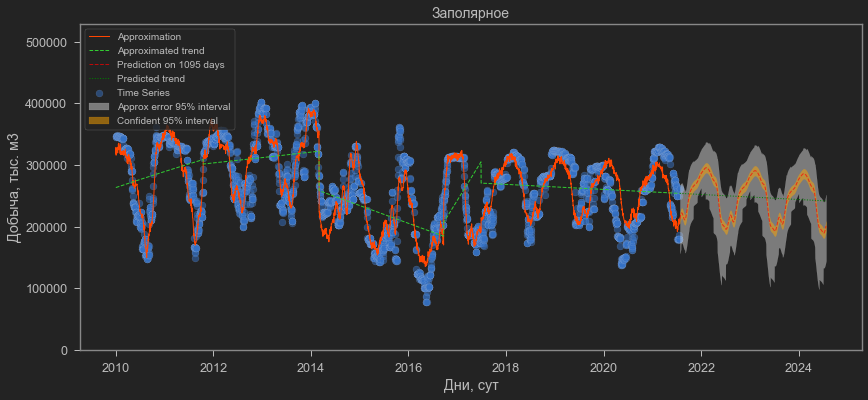

************************************************************************************************************************
The field "Ямбургское"
Change points: [2015.5 2017.6]
Fourier function of 8-th order
R2=0.922; MAE=11295.26 (mean_y=191935.64); RMSE=15997.46


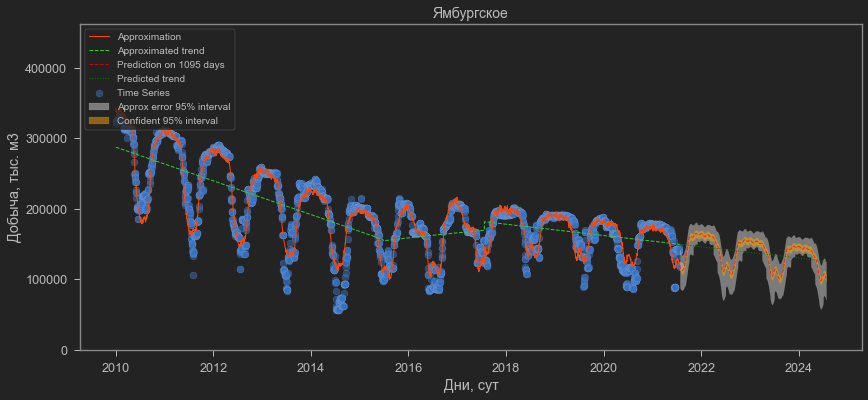

************************************************************************************************************************
The field "Бованенковское"
Change points: [nan]
Fourier function of 8-th order
R2=0.934; MAE=16478.11 (mean_y=188021.84); RMSE=23400.26


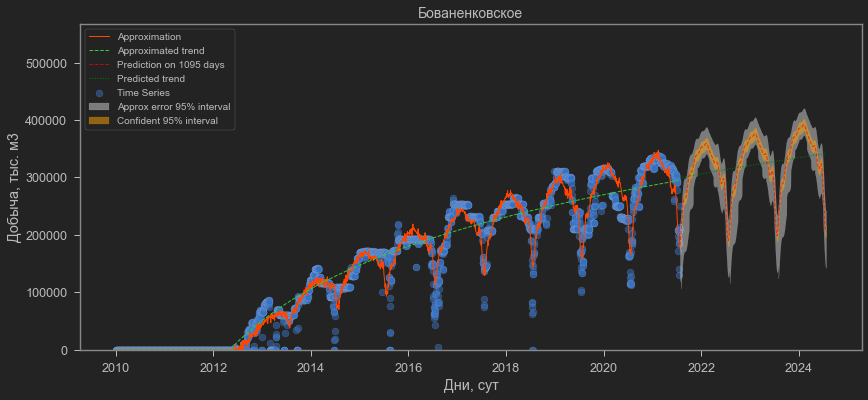

************************************************************************************************************************
The field "Медвежье (сеном)"
Change points: [2012.2 2014.4 2016.7 2019.4 2019.7]
Fourier function of 8-th order
R2=0.921; MAE=1739.79 (mean_y=22380.67); RMSE=2978.77


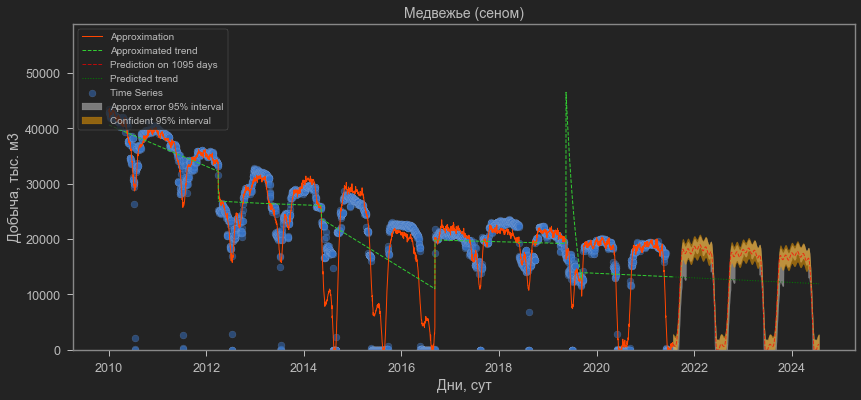

************************************************************************************************************************
The field "УКПГ-НТС"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-0.079; MAE=343.42 (mean_y=2682.45); RMSE=759.64


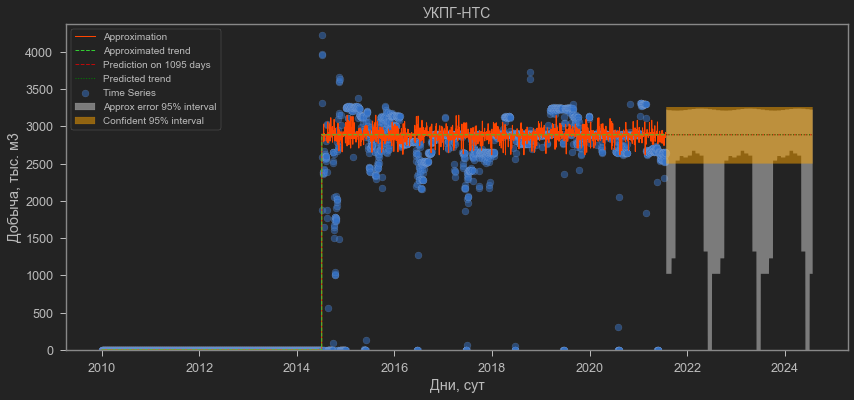

************************************************************************************************************************
The field "УКПГ-Ныда"
Change points: [2016.4]
Fourier function of 8-th order
R2=0.58; MAE=409.29 (mean_y=5257.23); RMSE=762.9


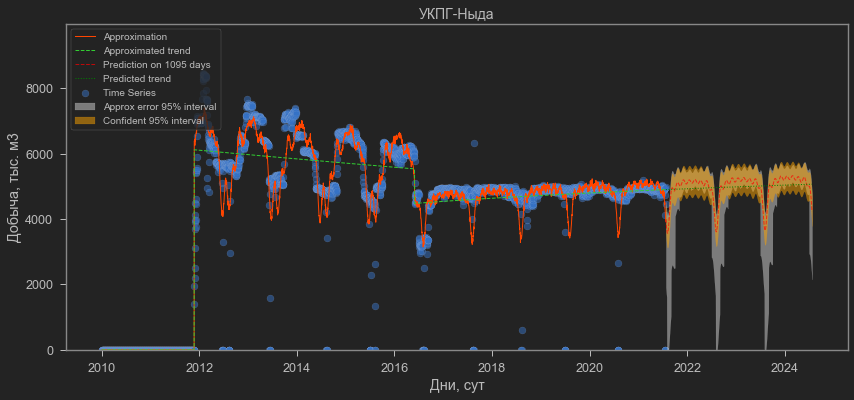

************************************************************************************************************************
The field "Харасавэйское"
Change points: [2018.3 2020.5]
Fourier function of 8-th order
R2=0.933; MAE=4.19 (mean_y=44.84); RMSE=11.35


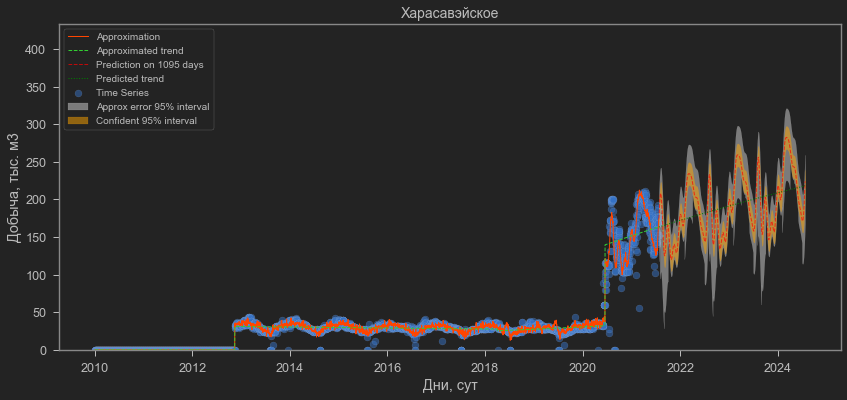

************************************************************************************************************************
The field "Юбилейное (сеном)"
Change points: [2014.  2016.7]
Fourier function of 8-th order
R2=0.816; MAE=4783.49 (mean_y=27738.2); RMSE=7465.2


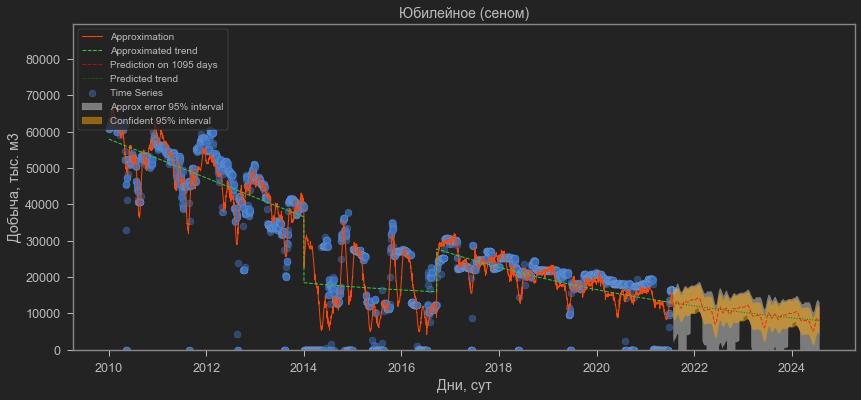

************************************************************************************************************************
The field "Ямсовейское"
Change points: [2012.3 2014.  2016.7 2018.8]
Fourier function of 8-th order
R2=0.714; MAE=6417.79 (mean_y=40990.22); RMSE=10055.39


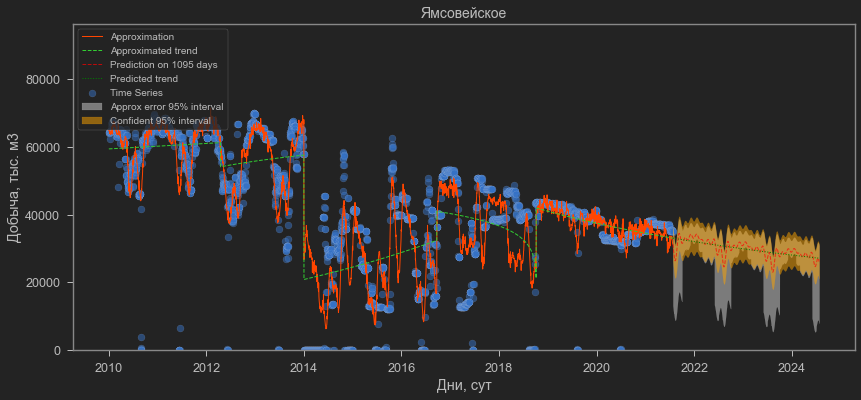

************************************************************************************************************************
The field "Вынгапуровское"
Change points: [2012.5 2014.4 2015.2 2016.4]
Fourier function of 8-th order
R2=0.871; MAE=241.95 (mean_y=1571.06); RMSE=448.68


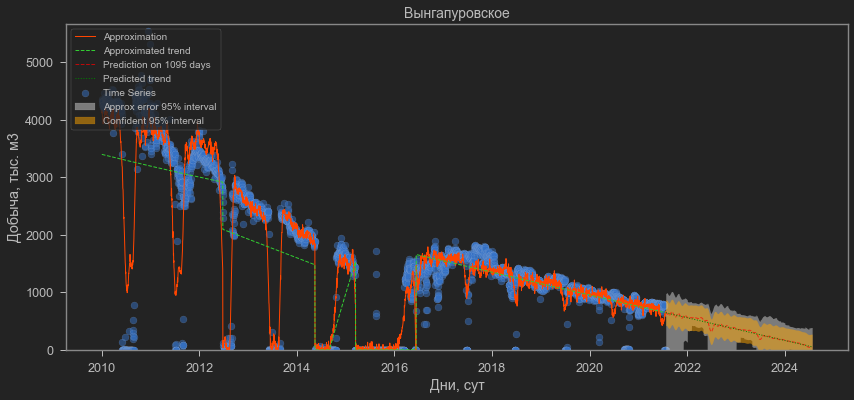

************************************************************************************************************************
The field "Вынгаяхинское"
Change points: [2013.4 2016.8 2019.7]
Fourier function of 8-th order
R2=0.74; MAE=835.01 (mean_y=13357.78); RMSE=1583.53


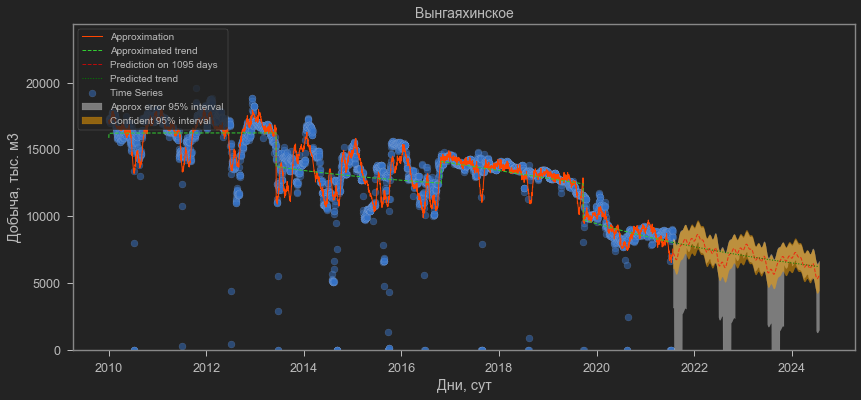

************************************************************************************************************************
The field "Еты-Пуровское"
Change points: [2016.8]
Fourier function of 8-th order
R2=0.697; MAE=2888.15 (mean_y=33218.36); RMSE=5054.8


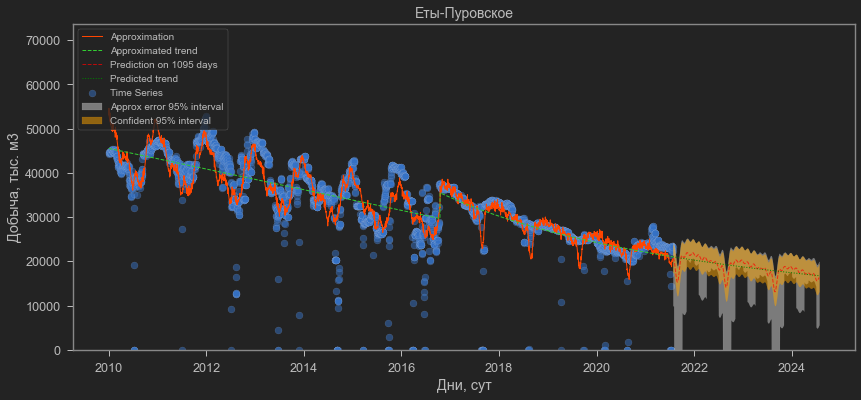

************************************************************************************************************************
The field "Зап.Таркосалинск."
Change points: [nan]
Fourier function of 8-th order
R2=0.938; MAE=1748.98 (mean_y=19770.39); RMSE=2802.36


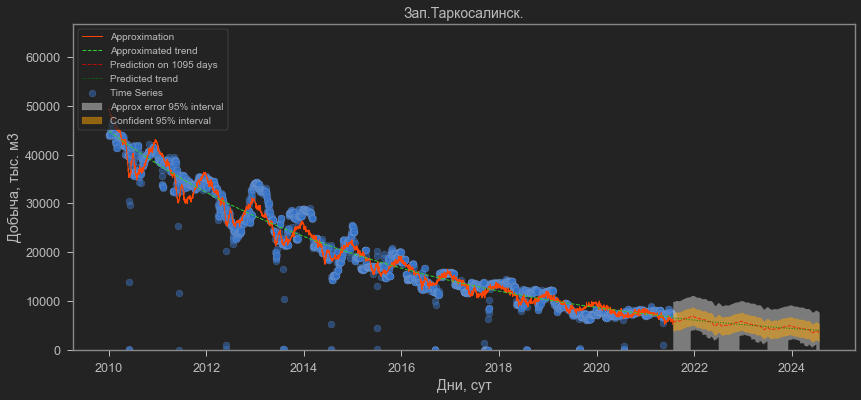

************************************************************************************************************************
The field "Комсомольское"
Change points: [2016.8]
Fourier function of 8-th order
R2=0.926; MAE=3030.1 (mean_y=31848.6); RMSE=5468.52


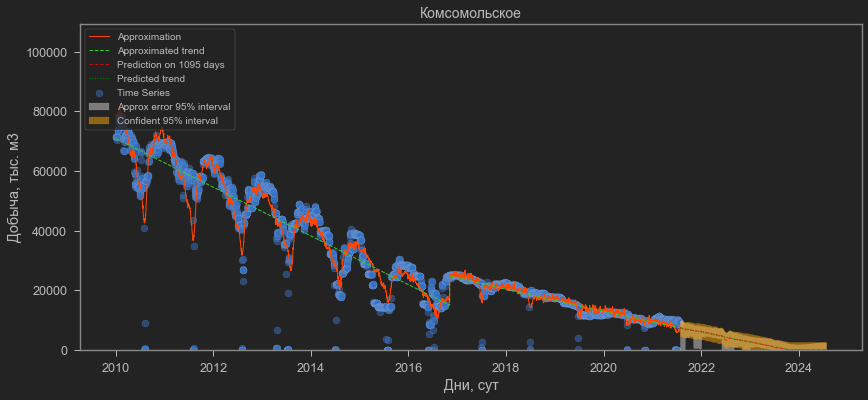

************************************************************************************************************************
The field "Астраханское ГКМ"
Change points: [2013.3]
Fourier function of 8-th order
R2=0.444; MAE=2299.32 (mean_y=30013.28); RMSE=3063.92


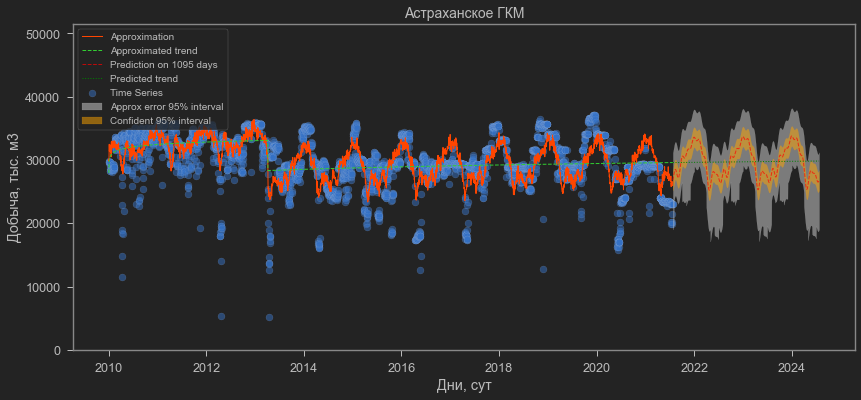

************************************************************************************************************************
The field "Болтное"
Change points: [2013.4 2015.6]
Fourier function of 8-th order
R2=0.445; MAE=3.77 (mean_y=15.08); RMSE=5.83


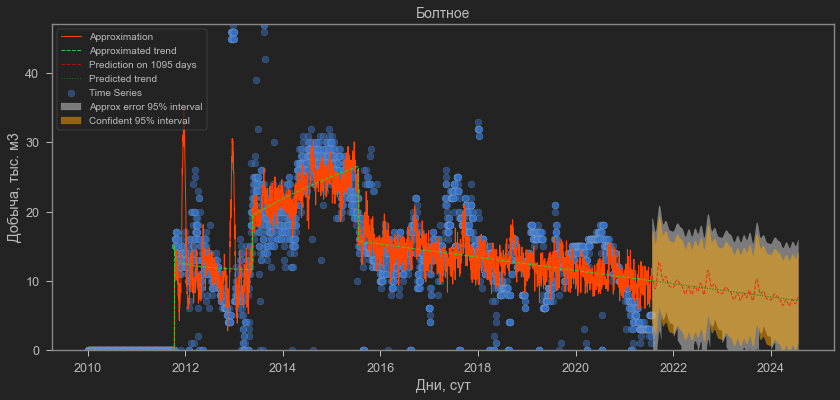

************************************************************************************************************************
The field "Казанское"
Change points: [2011.6 2014.7]
Fourier function of 8-th order
R2=0.865; MAE=211.53 (mean_y=2190.86); RMSE=379.33


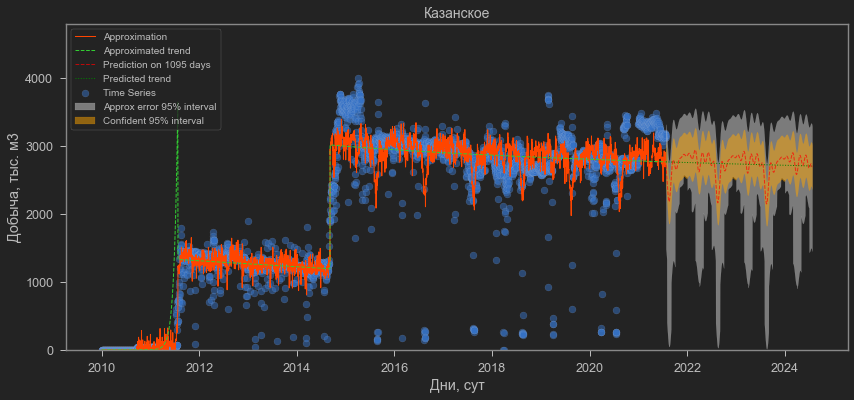

************************************************************************************************************************
The field "Мирное"
Change points: [2015.6 2018.6 2019.3]
Fourier function of 8-th order
R2=0.912; MAE=13.85 (mean_y=100.11); RMSE=27.97


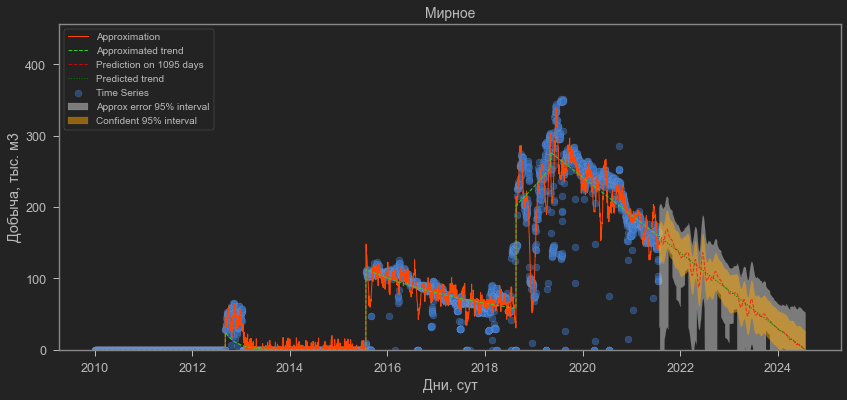

************************************************************************************************************************
The field "Мыльджинское"
Change points: [nan]
Fourier function of 8-th order
R2=0.671; MAE=458.94 (mean_y=4825.49); RMSE=745.19


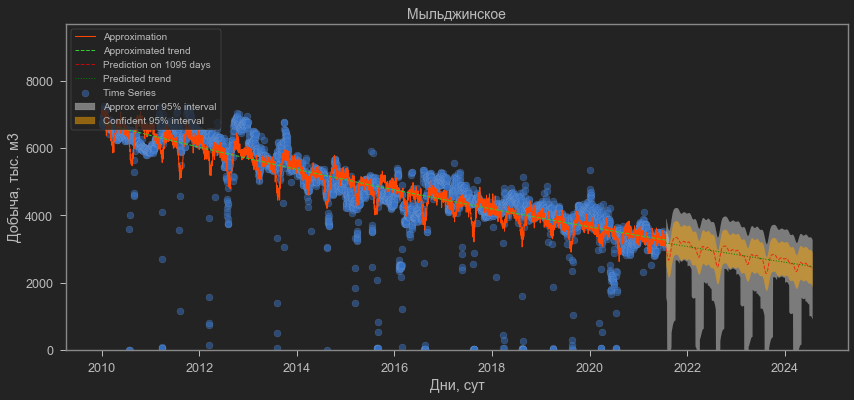

************************************************************************************************************************
The field "Останинское"
Change points: [2017.3 2020. ]
Fourier function of 8-th order
R2=0.857; MAE=119.32 (mean_y=856.38); RMSE=210.72


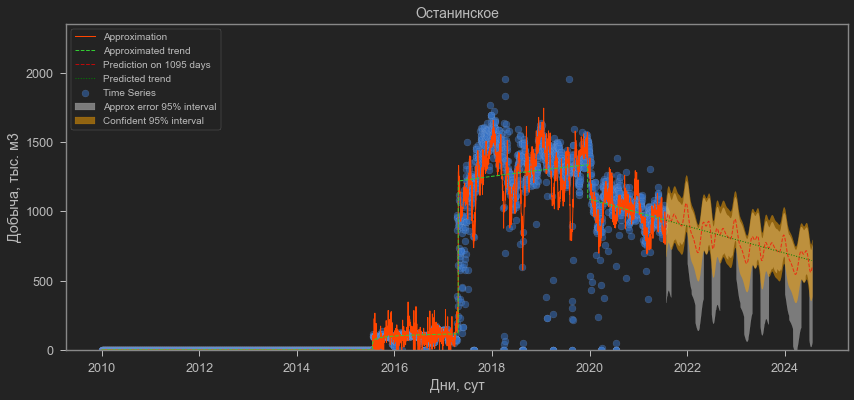

************************************************************************************************************************
The field "Пинджинское"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-1.77; MAE=2.83 (mean_y=1.37); RMSE=3.29


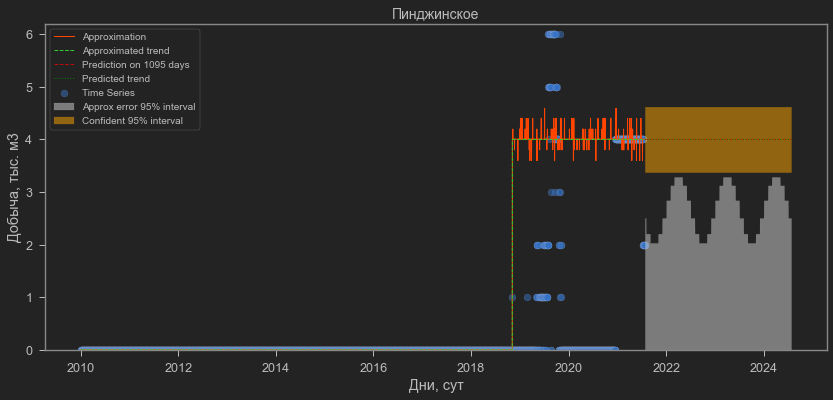

************************************************************************************************************************
The field "Рыбальное"
Change points: [2019.4 2021.4]
Fourier function of 8-th order
Use simple approximation median
R2=0.827; MAE=3.05 (mean_y=11.44); RMSE=6.02


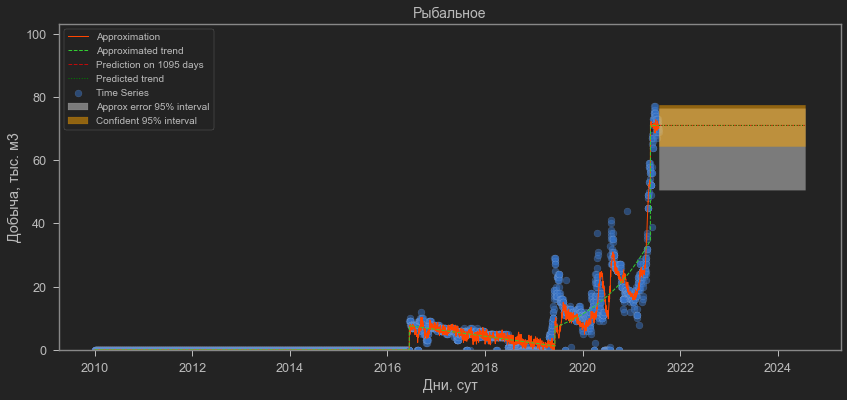

************************************************************************************************************************
The field "Северо-Васюганское"
Change points: [2012.8 2019.2]
Fourier function of 8-th order
R2=0.437; MAE=125.88 (mean_y=1570.94); RMSE=226.97


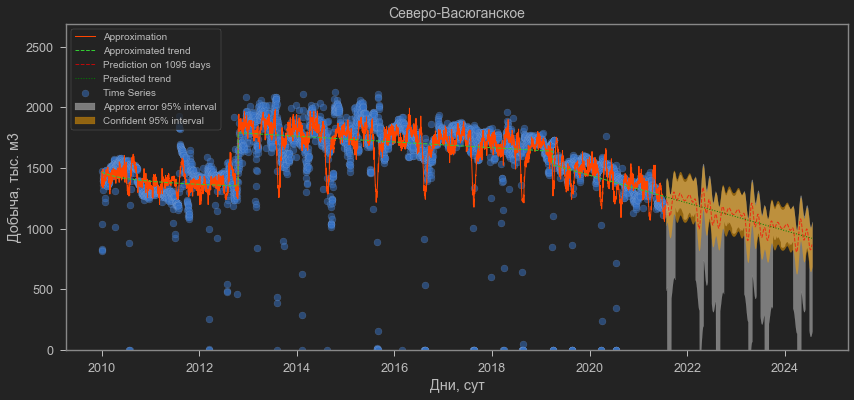

************************************************************************************************************************
The field "Северо-Останинское"
Change points: [2014.  2015.7 2017.7 2019.9]
Fourier function of 8-th order
R2=0.687; MAE=25.78 (mean_y=109.53); RMSE=40.8


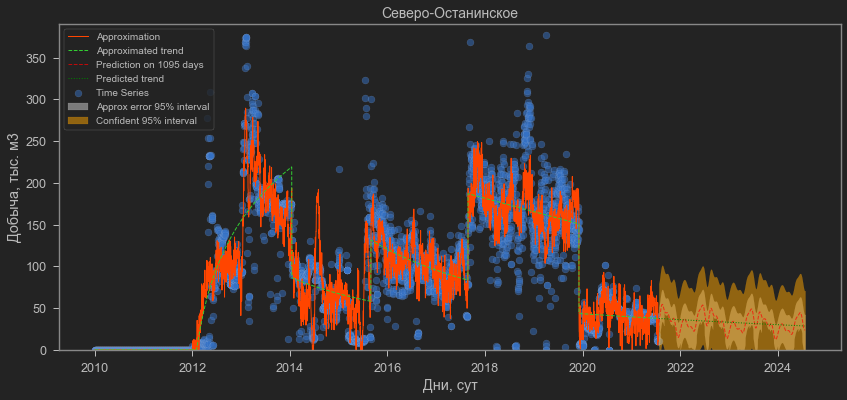

************************************************************************************************************************
The field "Ен.-Яхинское (В.)"


In [ ]:
result = pd.DataFrame()
prediction = 365*3
fields = df['Месторождение'].unique()

for field in fields:
    _result = time_series_approximation(df, field, fourier_order=8, noise_alpha=0.05, noise_window=5, changepoint_cutoff=0.965, prediction=prediction, exceptions=exceptions)
    _result['Месторождение'] = field
    result = pd.concat((result, _result), axis=0)

In [36]:
full_result = pd.merge(result, df[['Дата', 'Месторождение', 'Добыча']], how='left', on=['Месторождение', 'Дата'])
full_result['Residuals'] = full_result['Approximation'] - full_result['Добыча']
full_result['Series_Var'] = full_result['Series_STD'] ** 2

# Save approximation result
full_result.to_csv("approximation_result.csv")

In [15]:
exceptions = {'change_points': {# Improve the history matching by adding new change points
                                'Заполярное': [2735, 3450, 3855],
                                'Ямсовейское': [3200],
                                'Вынгапуровское': [1900],
                                'Еты-Пуровское': [2480],
                                'Комсомольское': [2500],
                                'ЗАО Пургаз (СП)': [2100],
                                'Южно-Русское НГКМ': [3660],
                                'Одесское': [2640, 2870],
                                'Западно-Салымское': [3775],
                                'Бейсугское ГМ': [2130],
                                'Платформа ПА-А': [1300, 2700],
                                'Ямбургское': [2000, 2760],
                                'Медвежье (сеном)': [3540],
                                'Вынгаяхинское': [2490],
                                'Мирное': [3410],
                                'УКПГ-22 (Ачимовка)': [1780, 3850],
                                'УКПГ-31 (Ачимгаз)': [1050],
                                "ОАО МегионНГ": [3750],
                                "ОАО МегионНГГеология": [2785],
                                "Патроновское ГКМ": [3200, 3790],
                                "Зап.-Красноармейское ГМ": [3845],
                                "Казанское": [570],
                                "ОАО НГК Славнефть (Ачим.)": [2900],
                                "Граничное ГКМ": [2530],
                                "ОАО ОбьНГГеология": [1800],
                                "УНГП": [2020],
                                "ООО Сервиснефтегаз": [2020],
                                
                                # Correction of not fitted fields
                                'Харасавэйское': [3820],
                                'Урмано-Арчинская гр.': [3800],
                                'Гречаное ГМ': [2300, 3945],
                                'Ю.Черноерковск.НГКМ': [3545],
                                "Чаяндинское": [4010],
                                "Тазовское (МНГ)": [4159],
                                "Рыбальное": [3445, 4160],
                                "Фонтановское": [3950],
                                "Киринское ГКМ": [1830],
                                "Северо-Булганакское": [3290],
                                },
              'simple_approximation': {# Use simple approximation for series with lack of data
                                       "Тазовское (МНГ)": np.median, 
                                       "Рыбальное": np.median,
                                       "Ен.-Яхинское (ГПН-Зап)": np.median, 
                                       "УКПГ-51 (АчимДевелопмент)": np.median,
                                       "Чаяндинское": np.median,
                                       "УКПГ-НТС": np.median,
                                       "Фонтановское": np.median,
                                       "Киринское ГКМ": np.mean,
                                       "ГПД Шельф": np.median,
                                       "Зап.-Красноармейское ГМ": np.median,
                                      },
              'own_trend': pd.DataFrame(columns=['Дата', 'Собственные нужды', 'Месторождение']),
             }

************************************************************************************************************************
The field "Заполярное"
Change points: [2013.4 2017.5 2018.7 2019.5 2020.6]
Fourier function of 8-th order
R2=0.934; MAE=142.83 (mean_y=2280.39); RMSE=191.86


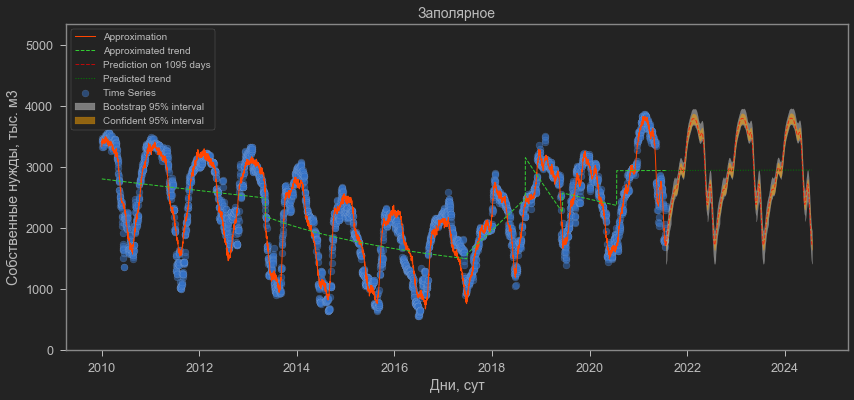

************************************************************************************************************************
The field "Тазовское (МНГ)"
Change points: [2017.3 2020.  2021.4]
Fourier function of 8-th order
Use simple approximation median
R2=0.659; MAE=0.97 (mean_y=2.37); RMSE=7.38


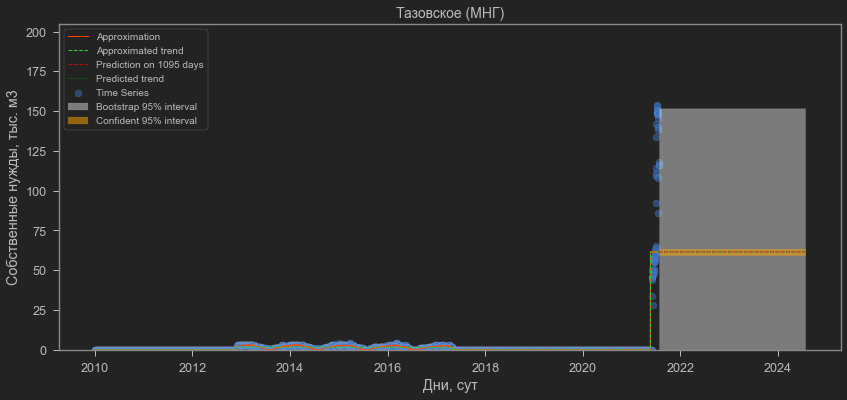

************************************************************************************************************************
The field "Ямбургское"
Change points: [2015.5 2017.6 2018.7]
Fourier function of 8-th order
R2=0.898; MAE=150.29 (mean_y=1692.88); RMSE=215.76


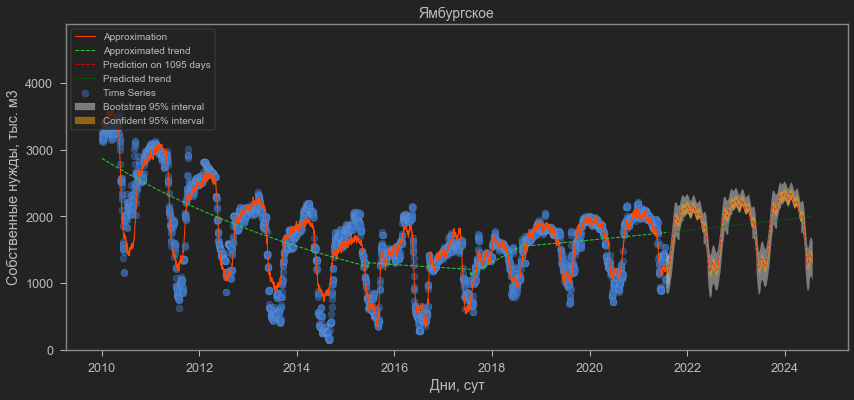

************************************************************************************************************************
The field "Бованенковское"
Change points: [2015.3]
Fourier function of 8-th order
R2=0.929; MAE=257.49 (mean_y=2268.97); RMSE=342.2


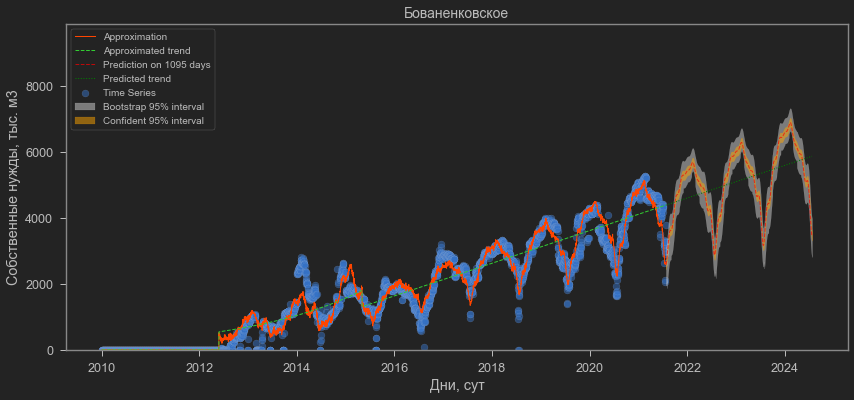

************************************************************************************************************************
The field "Медвежье (сеном)"
Change points: [2012.2 2014.4 2016.8 2019.4 2019.7]
Fourier function of 8-th order
R2=0.916; MAE=29.98 (mean_y=289.34); RMSE=45.82


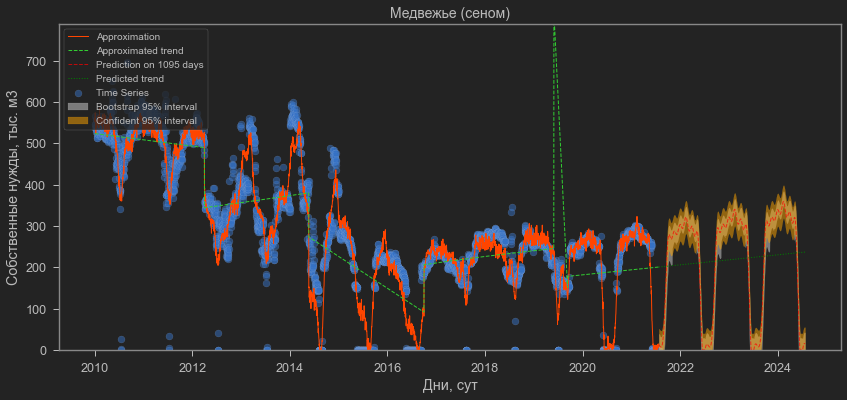

************************************************************************************************************************
The field "УКПГ-НТС"
Change points: [2017.8]
Fourier function of 8-th order
Use simple approximation median
R2=0.493; MAE=4.68 (mean_y=31.12); RMSE=7.38


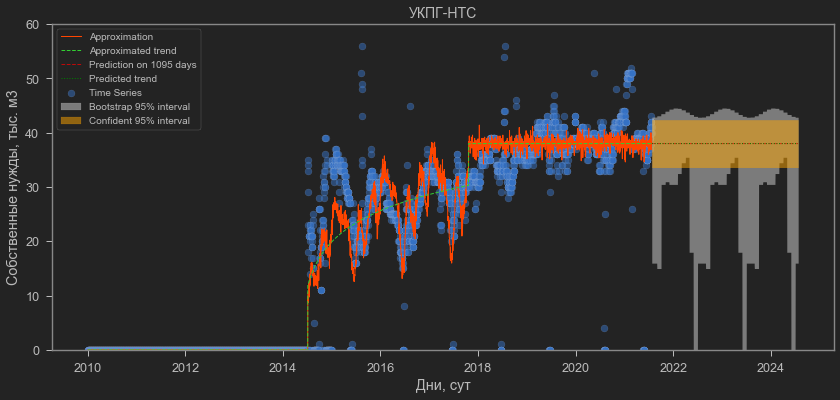

************************************************************************************************************************
The field "УКПГ-Ныда"
Change points: [2014.4 2016.3]
Fourier function of 8-th order
R2=0.745; MAE=6.78 (mean_y=64.69); RMSE=10.95


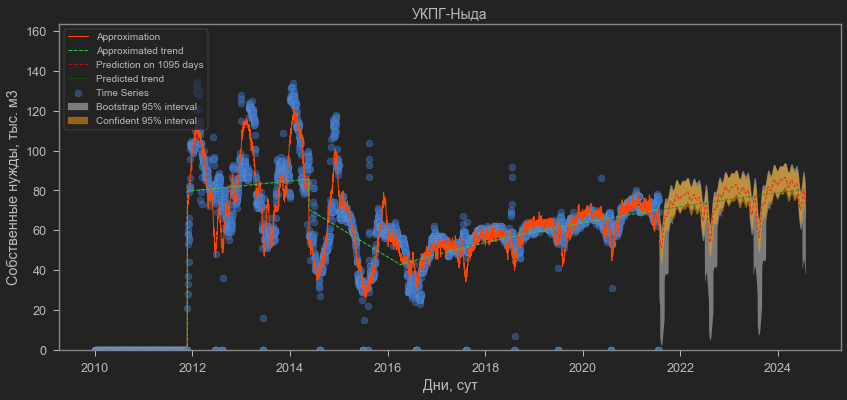

************************************************************************************************************************
The field "Харасавэйское"
Change points: [2015.  2020.5]
Fourier function of 8-th order
R2=0.92; MAE=0.08 (mean_y=0.34); RMSE=0.22


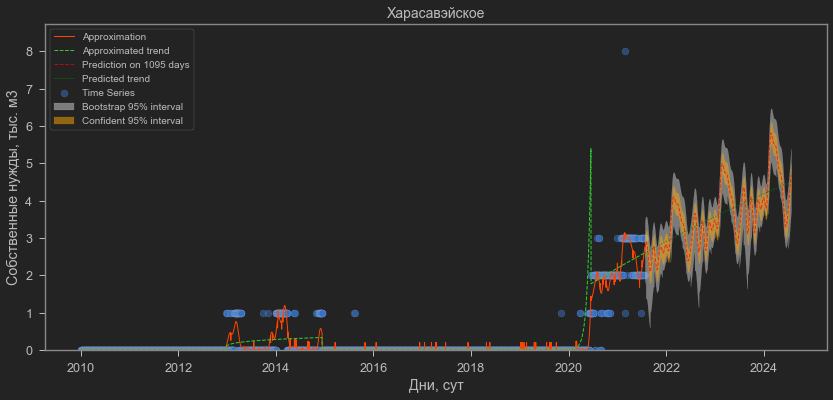

************************************************************************************************************************
The field "Юбилейное (сеном)"
Change points: [2013.3 2016.7]
Fourier function of 8-th order
R2=0.838; MAE=74.2 (mean_y=355.33); RMSE=101.47


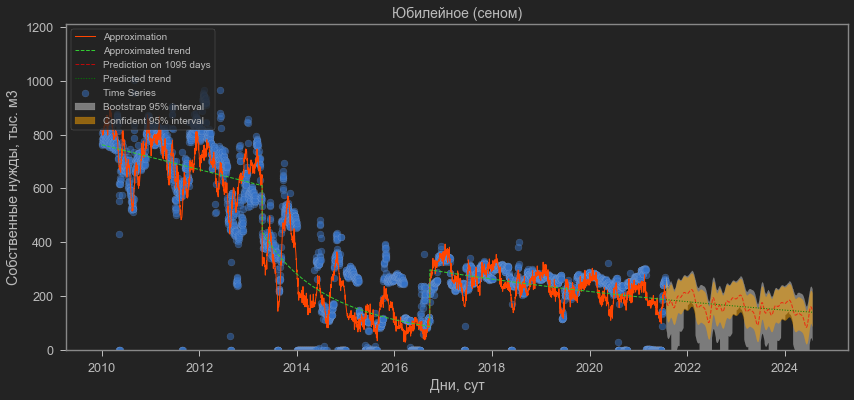

************************************************************************************************************************
The field "Ямсовейское"
Change points: [2012.3 2014.  2016.7 2018.7 2018.8]
Fourier function of 8-th order
R2=0.792; MAE=83.09 (mean_y=520.38); RMSE=125.15


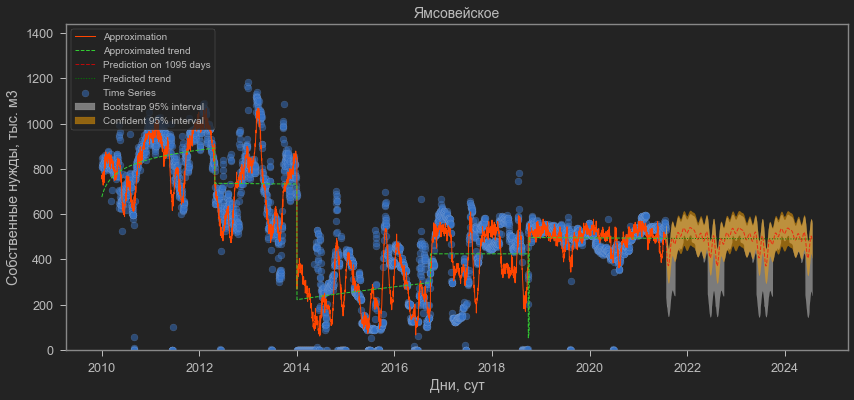

************************************************************************************************************************
The field "Вынгапуровское"
Change points: [2013.4 2015.2 2016.5]
Fourier function of 8-th order
R2=0.765; MAE=5.88 (mean_y=31.52); RMSE=9.43


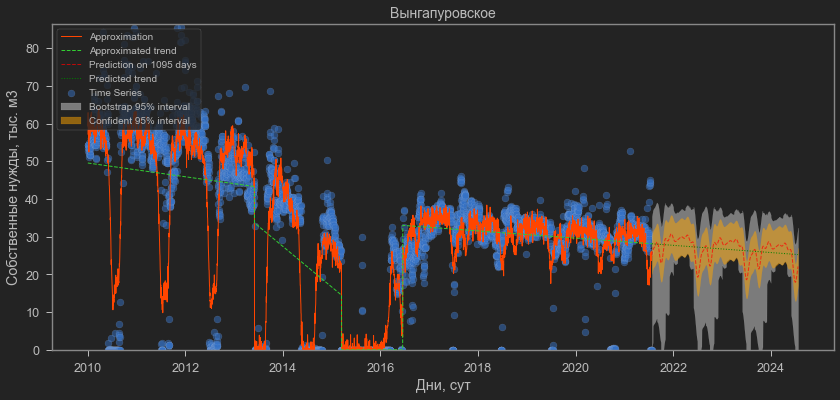

************************************************************************************************************************
The field "Вынгаяхинское"
Change points: [2011.7 2014.3 2016.8 2016.8 2018.6]
Fourier function of 8-th order
R2=0.681; MAE=25.03 (mean_y=278.02); RMSE=38.75


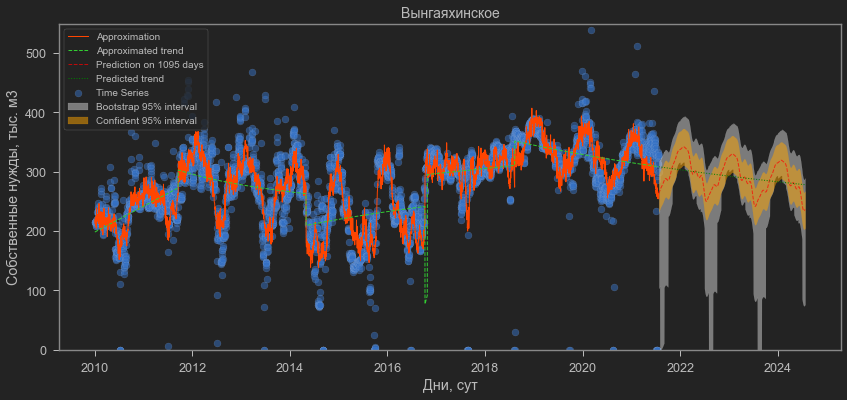

************************************************************************************************************************
The field "Еты-Пуровское"
Change points: [2014.2 2016.8]
Fourier function of 8-th order
R2=0.565; MAE=80.15 (mean_y=686.51); RMSE=120.88


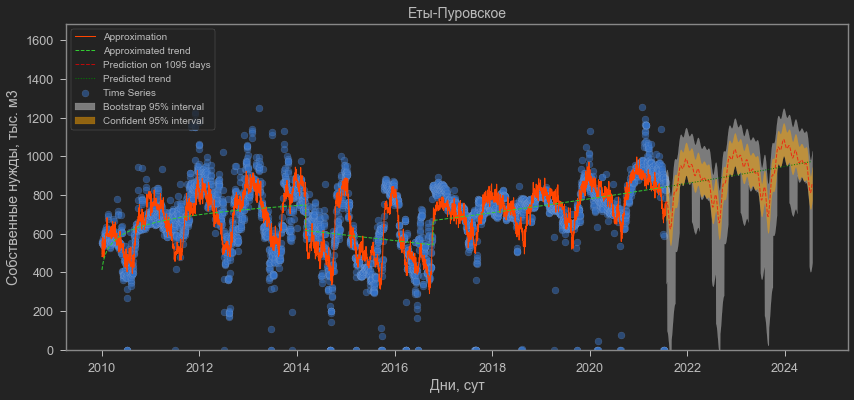

************************************************************************************************************************
The field "Зап.Таркосалинск."
Change points: [2012.4 2014.4 2016.1]
Fourier function of 8-th order
R2=0.817; MAE=45.05 (mean_y=374.95); RMSE=65.11


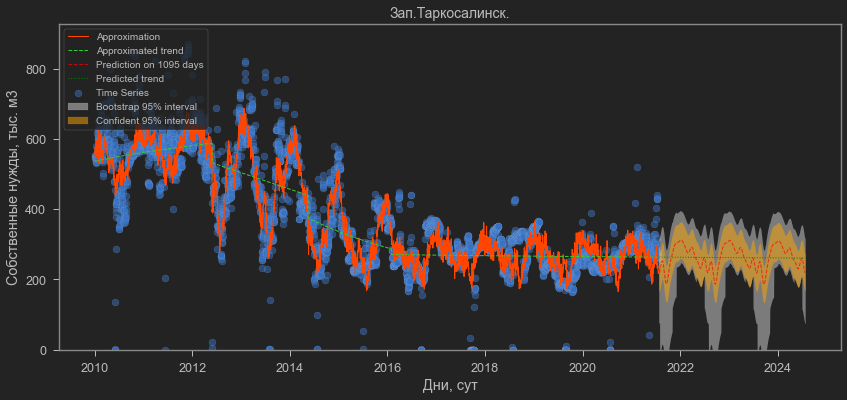

************************************************************************************************************************
The field "Комсомольское"
Change points: [2012.4 2014.4 2016.8 2016.8 2019.4]
Fourier function of 8-th order
R2=0.853; MAE=69.29 (mean_y=605.2); RMSE=109.52


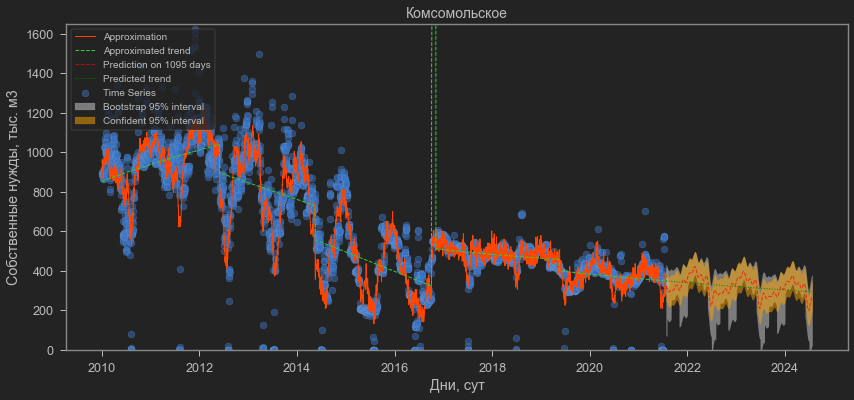

************************************************************************************************************************
The field "ЗАО Пургаз (СП)"
Change points: [2015.8]
Fourier function of 8-th order
R2=0.245; MAE=18.72 (mean_y=286.72); RMSE=38.26


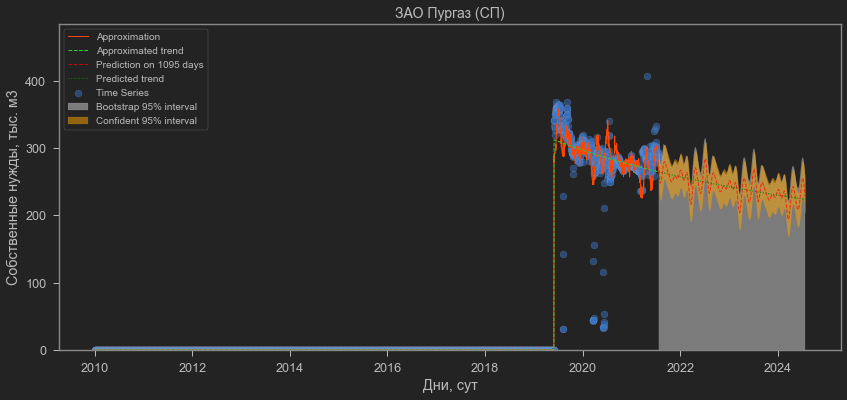

************************************************************************************************************************
The field "Астраханское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.548; MAE=29.37 (mean_y=409.76); RMSE=42.61


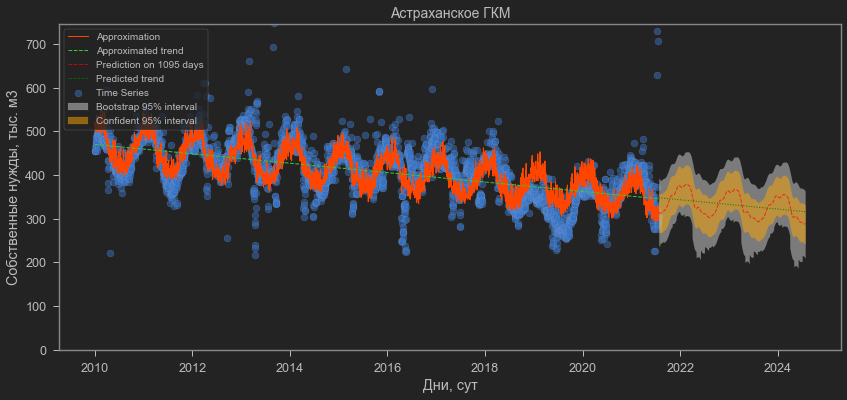

************************************************************************************************************************
The field "Болтное"
Change points: [2013.4 2015.6]
Fourier function of 8-th order
R2=0.348; MAE=0.19 (mean_y=0.71); RMSE=0.29


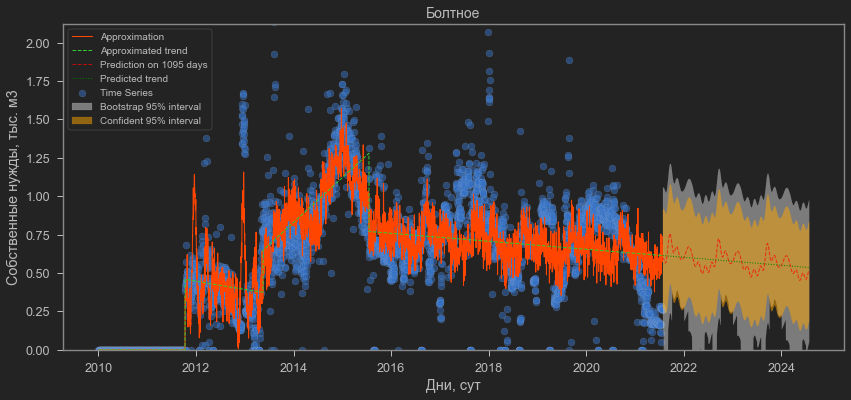

************************************************************************************************************************
The field "Газ переработки (ГПД Томск)"
Change points: [2019.3]
Fourier function of 8-th order
R2=0.673; MAE=2.46 (mean_y=14.37); RMSE=4.23


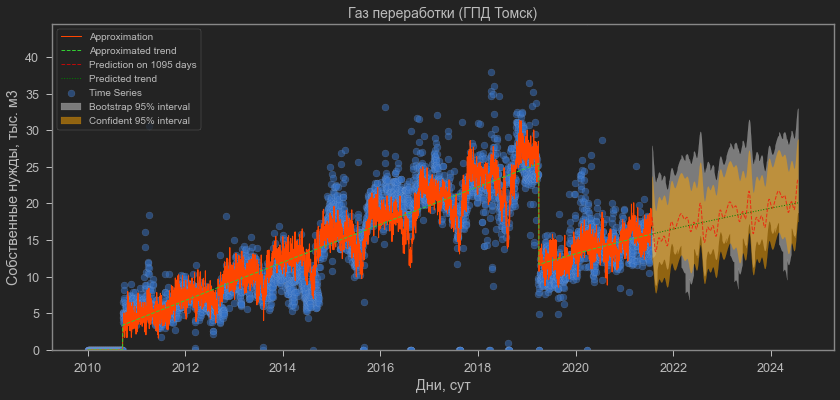

************************************************************************************************************************
The field "Казанское"
Change points: [2011.6 2014.7 2019.6]
Fourier function of 8-th order
R2=0.874; MAE=12.92 (mean_y=112.97); RMSE=23.27


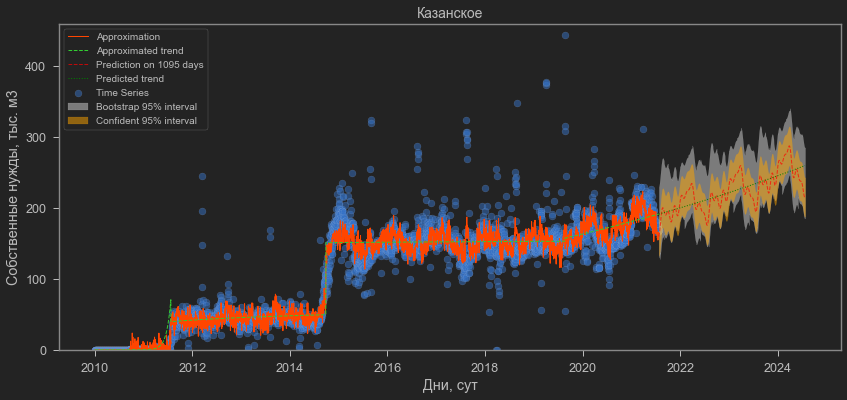

************************************************************************************************************************
The field "Мирное"
Change points: [2015.6 2018.6 2019.3]
Fourier function of 8-th order
R2=0.879; MAE=0.85 (mean_y=5.51); RMSE=1.91


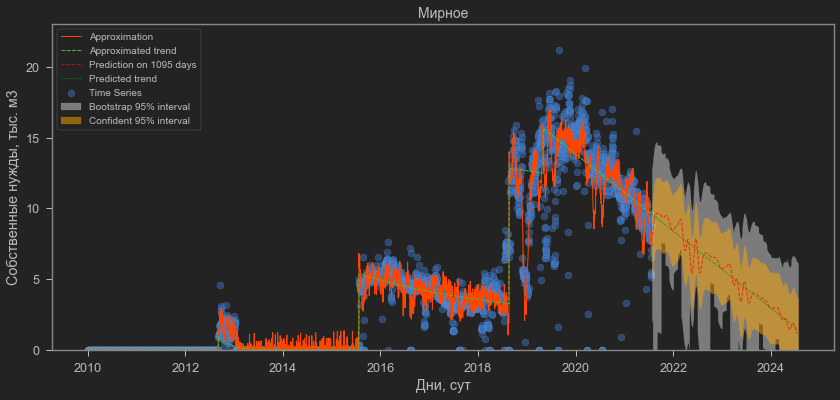

************************************************************************************************************************
The field "Мыльджинское"
Change points: [nan]
Fourier function of 8-th order
R2=0.238; MAE=27.73 (mean_y=204.65); RMSE=41.5


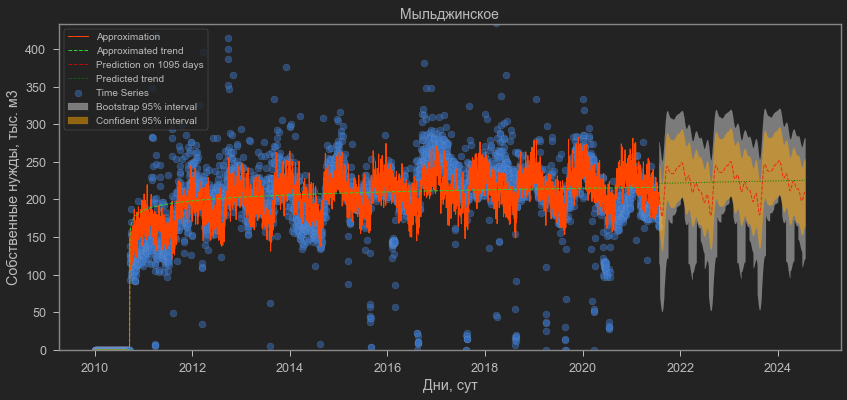

************************************************************************************************************************
The field "Останинское"
Change points: [2017.4 2020. ]
Fourier function of 8-th order
R2=0.835; MAE=7.35 (mean_y=47.33); RMSE=12.79


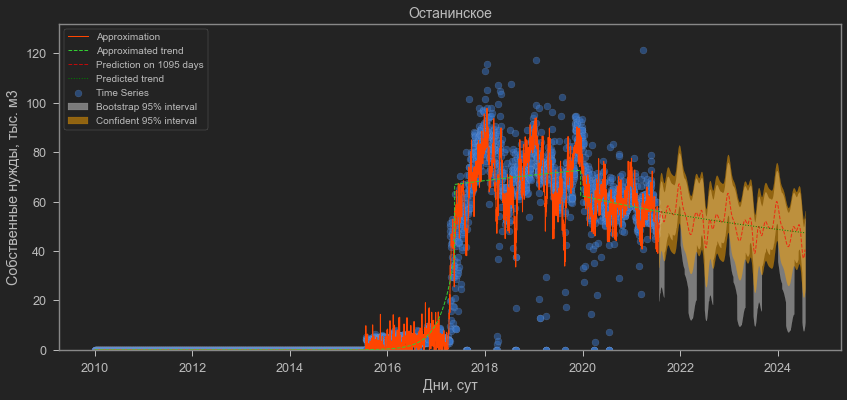

************************************************************************************************************************
The field "Рыбальное"
Change points: [2019.4 2021.4]
Fourier function of 8-th order
Use simple approximation median
R2=0.837; MAE=0.18 (mean_y=0.65); RMSE=0.34


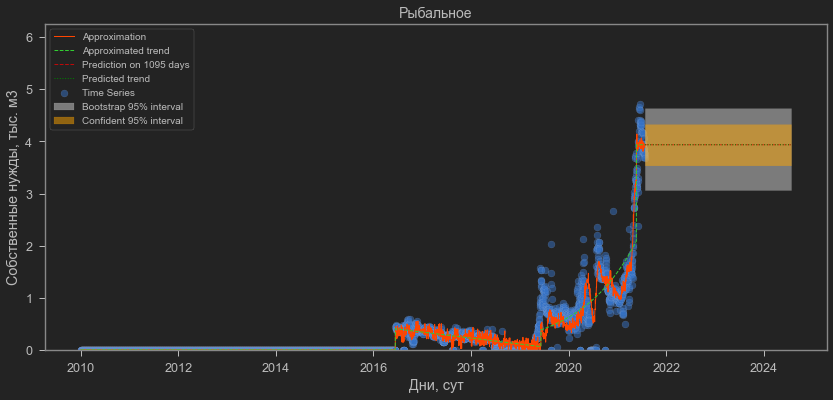

************************************************************************************************************************
The field "Северо-Васюганское"
Change points: [2019.2]
Fourier function of 8-th order
R2=0.635; MAE=8.98 (mean_y=72.1); RMSE=14.33


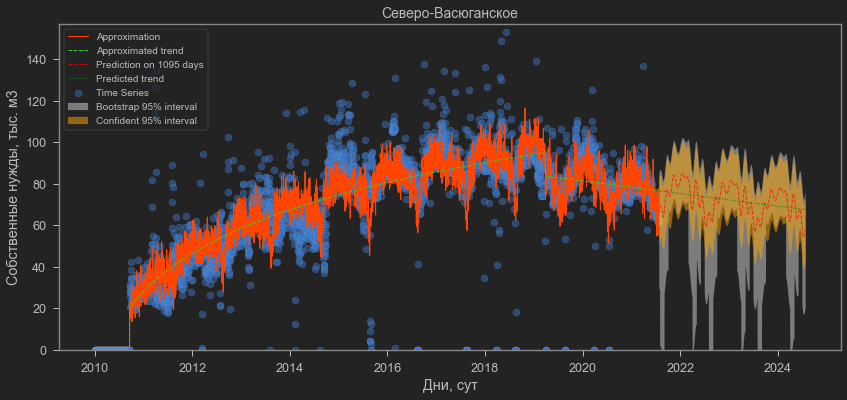

************************************************************************************************************************
The field "Северо-Останинское"
Change points: [2013.9 2015.5 2017.6 2019.9]
Fourier function of 8-th order
R2=0.587; MAE=1.4 (mean_y=5.44); RMSE=2.78


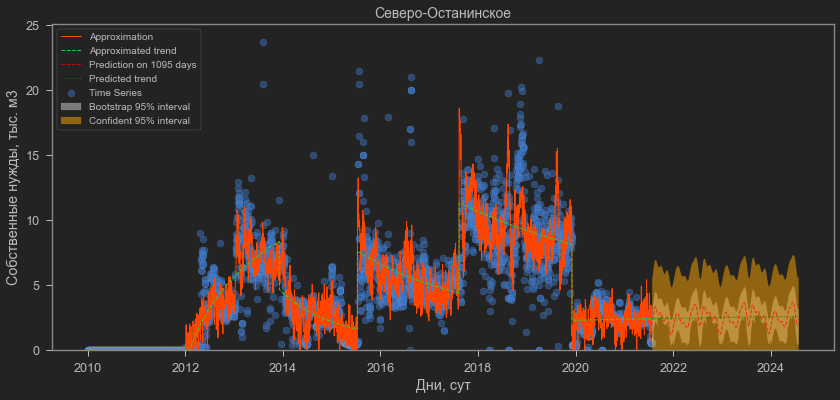

************************************************************************************************************************
The field "Урмано-Арчинская гр."
Change points: [2020.4]
Fourier function of 8-th order
R2=0.445; MAE=7.95 (mean_y=68.76); RMSE=12.37


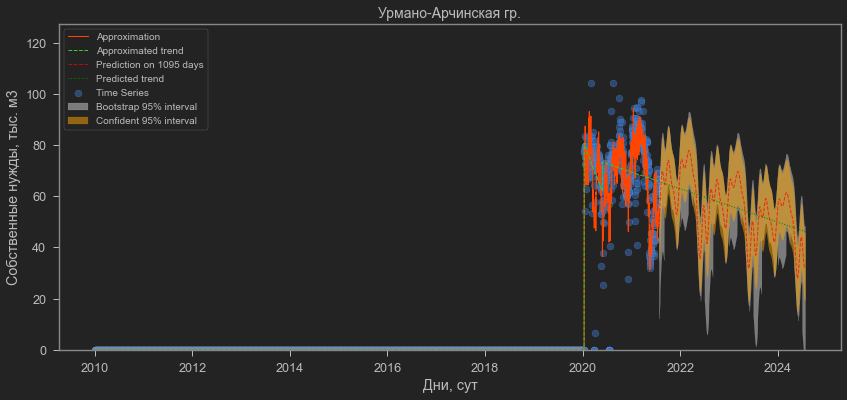

************************************************************************************************************************
The field "Шингинское"
Change points: [2019.9]
Fourier function of 8-th order
R2=0.618; MAE=4.73 (mean_y=18.42); RMSE=7.78


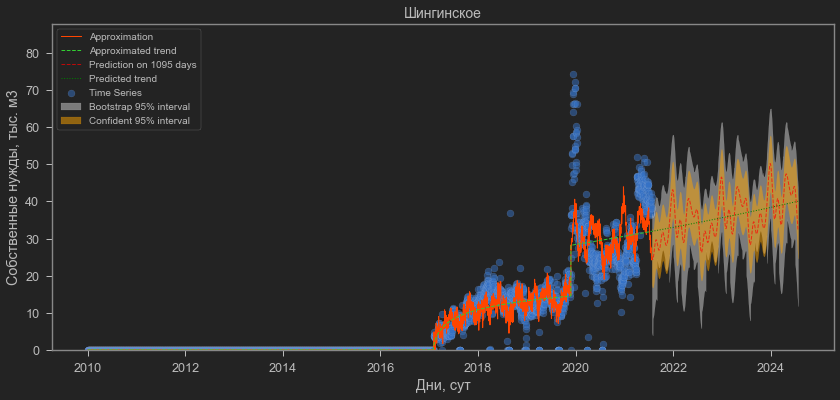

************************************************************************************************************************
The field "Ен.-Яхинское (В.)"
Change points: [2019.6]
Fourier function of 8-th order
R2=0.253; MAE=20.12 (mean_y=207.16); RMSE=32.1


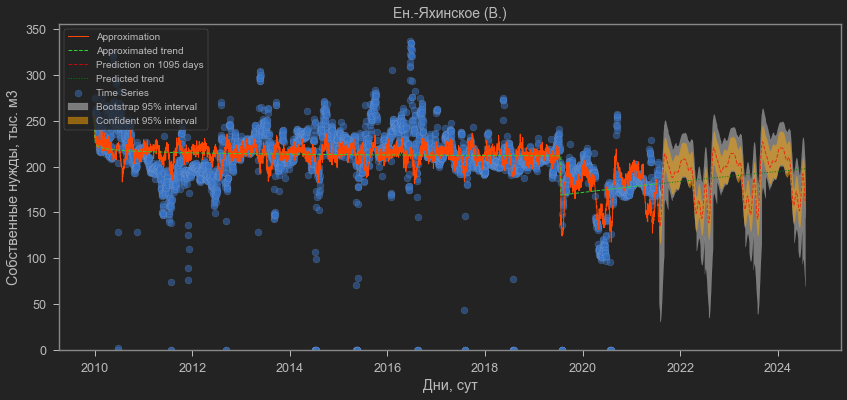

************************************************************************************************************************
The field "Ен.-Яхинское (ГПН-Зап)"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-0.129; MAE=3.34 (mean_y=16.3); RMSE=4.74


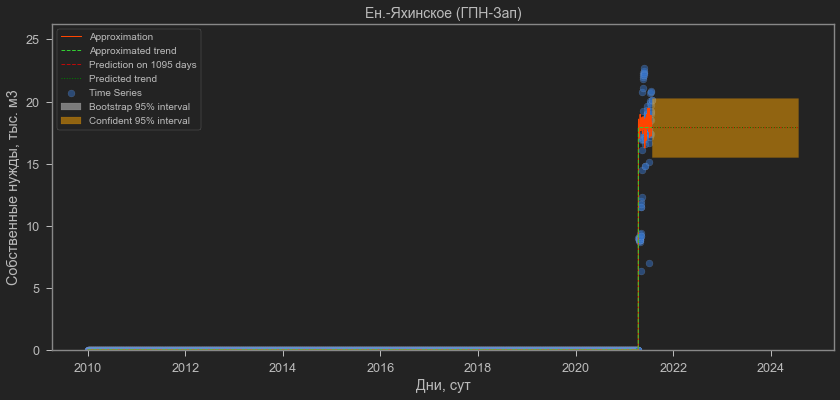

************************************************************************************************************************
The field "ЗАО Нортгаз"
Change points: [2011.7 2013.8 2017.5]
Fourier function of 8-th order
R2=0.945; MAE=13.95 (mean_y=144.79); RMSE=29.13


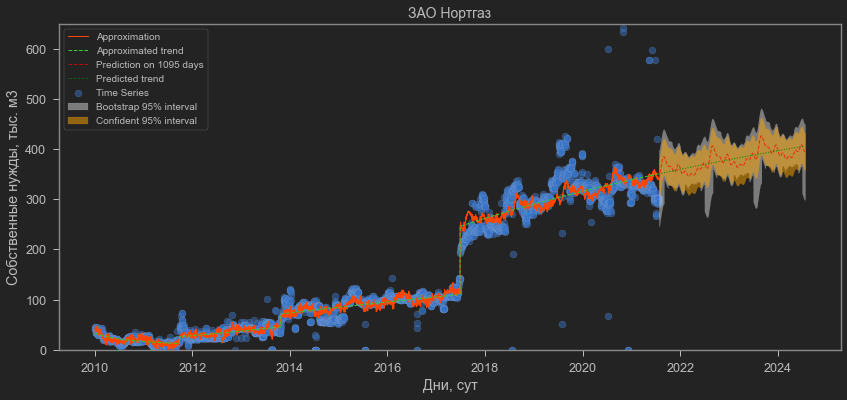

************************************************************************************************************************
The field "НГДУ (валанжин)"
Change points: [nan]
Fourier function of 8-th order
R2=0.549; MAE=6.2 (mean_y=48.25); RMSE=9.97


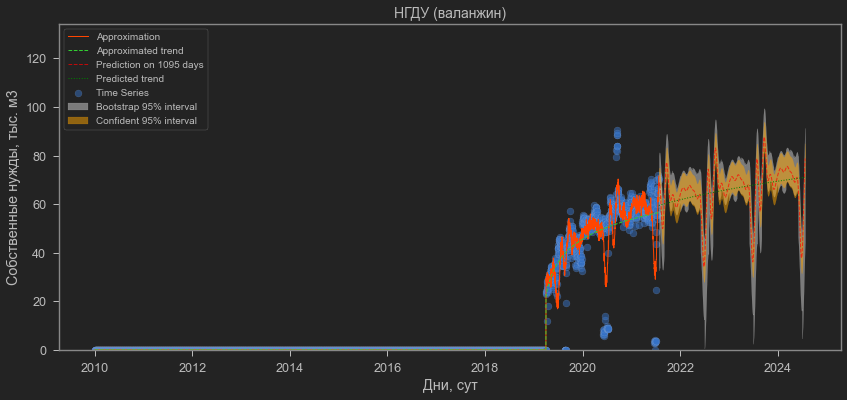

************************************************************************************************************************
The field "НГДУ (попутныйгаз)"
Change points: [nan]
Fourier function of 8-th order
R2=0.243; MAE=2.56 (mean_y=14.58); RMSE=3.32


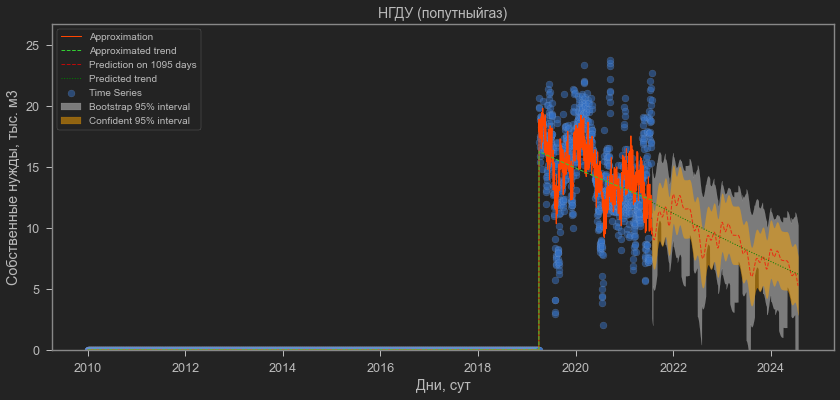

************************************************************************************************************************
The field "Песцовое"
Change points: [2014.2 2016.8]
Fourier function of 8-th order
R2=0.654; MAE=159.8 (mean_y=1181.34); RMSE=224.27


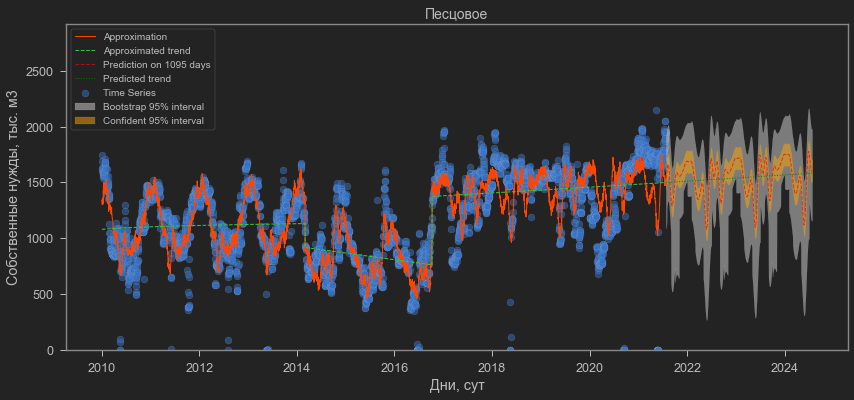

************************************************************************************************************************
The field "УКПГ-22 (Ачимовка)"
Change points: [2014.9 2020.5]
Fourier function of 8-th order
R2=0.869; MAE=17.53 (mean_y=123.87); RMSE=29.79


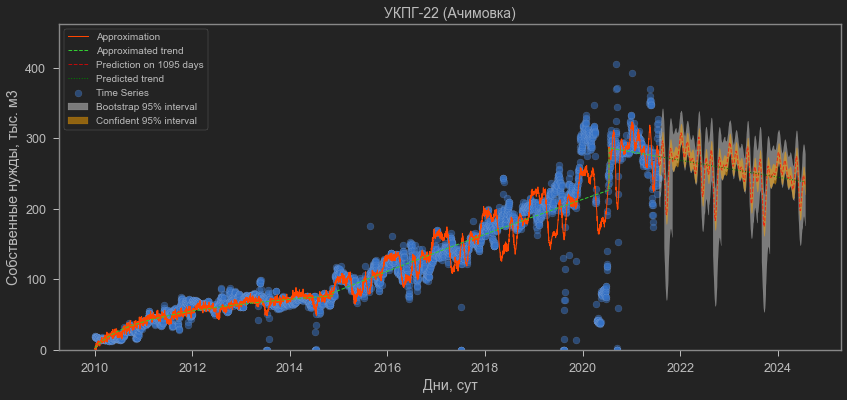

************************************************************************************************************************
The field "УКПГ-31 (Ачимгаз)"
Change points: [2012.9 2013.8]
Fourier function of 8-th order
R2=0.926; MAE=36.69 (mean_y=299.47); RMSE=63.25


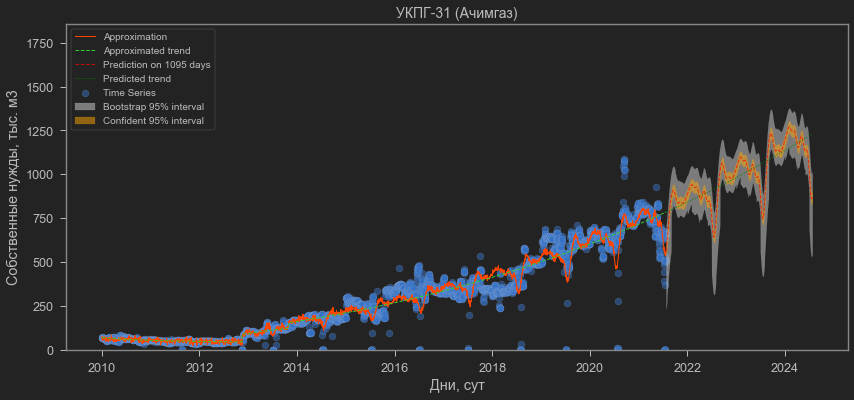

************************************************************************************************************************
The field "УКПГ-41 (АчимДевелопмент)"
Change points: [nan]
Fourier function of 8-th order
R2=0.67; MAE=12.97 (mean_y=132.37); RMSE=18.85


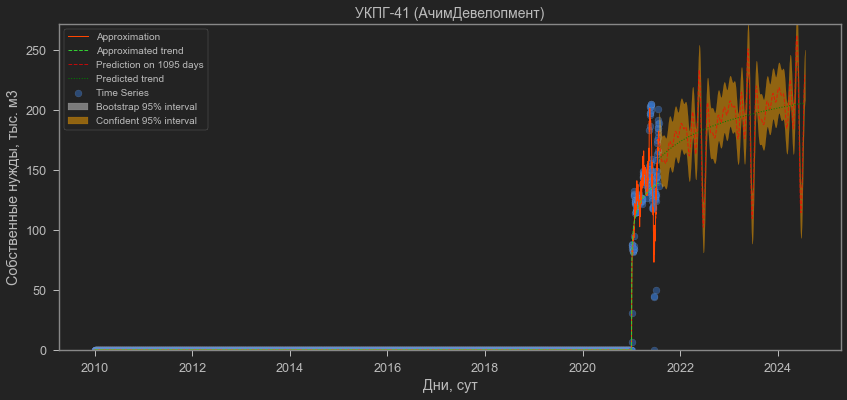

************************************************************************************************************************
The field "УКПГ-51 (АчимДевелопмент)"
Change points: [nan]
Fourier function of 8-th order
Use simple approximation median
R2=-0.0183; MAE=14.61 (mean_y=84.04); RMSE=19.26


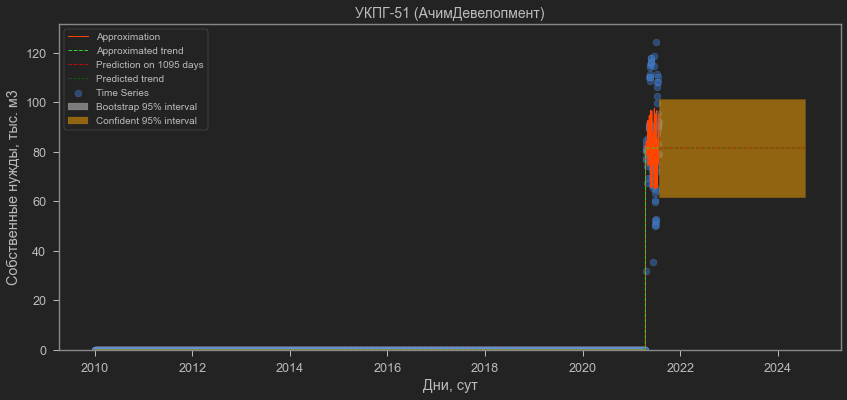

************************************************************************************************************************
The field "Уренгойское"
Change points: [2017.7]
Fourier function of 8-th order
R2=0.748; MAE=285.75 (mean_y=3140.7); RMSE=390.13


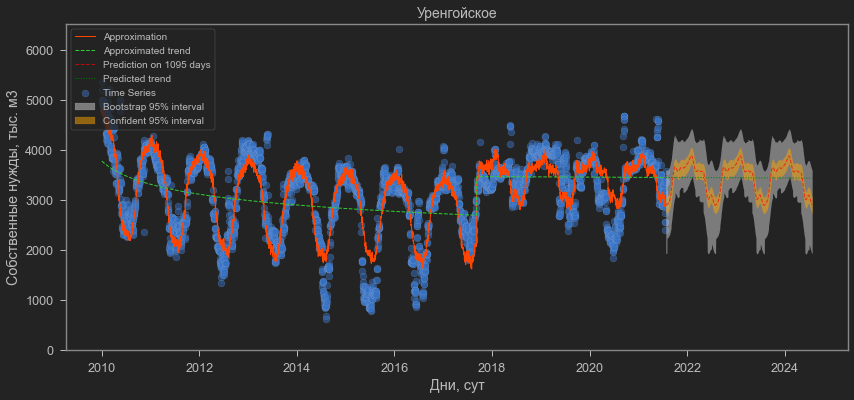

************************************************************************************************************************
The field "Южно-Русское НГКМ"
Change points: [2020.]
Fourier function of 8-th order
R2=0.872; MAE=15.16 (mean_y=150.8); RMSE=34.05


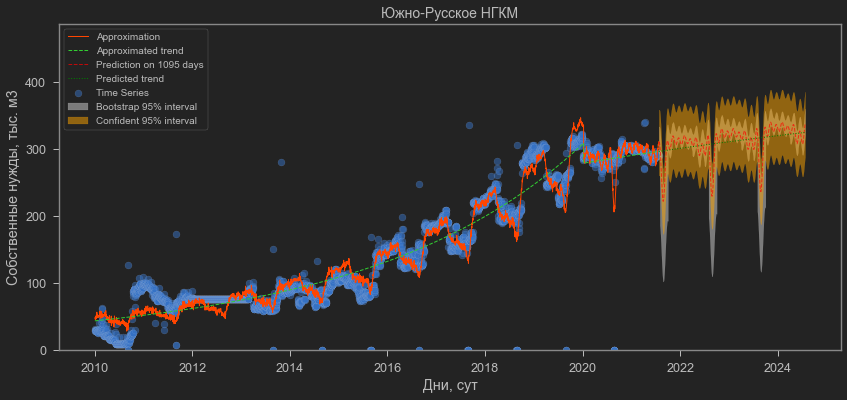

************************************************************************************************************************
The field "ОАО МегионНГ"
Change points: [2020.  2020.3]
Fourier function of 8-th order
R2=0.573; MAE=146.83 (mean_y=1377.96); RMSE=327.09


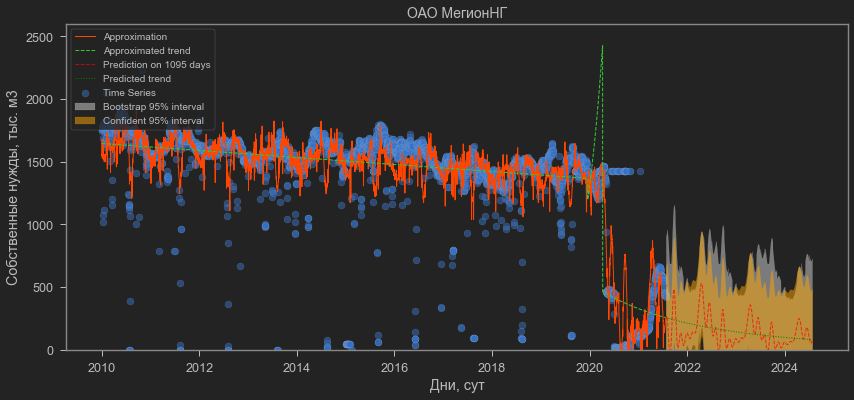

************************************************************************************************************************
The field "ОАО МегионНГГеология"
Change points: [2015.7 2017.6]
Fourier function of 8-th order
R2=0.77; MAE=2.25 (mean_y=9.86); RMSE=3.71


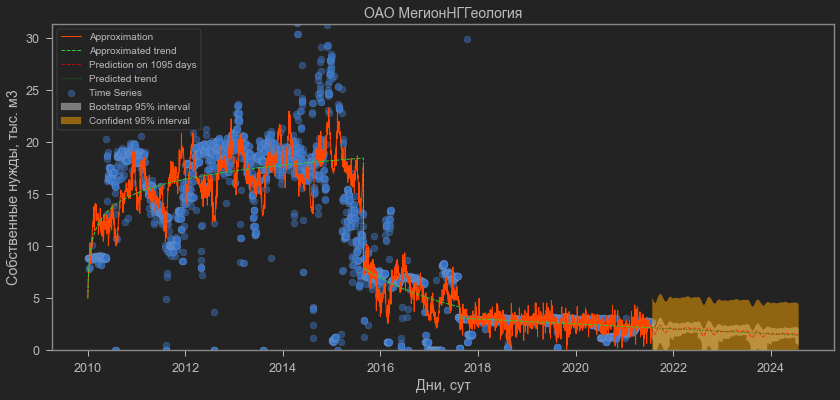

************************************************************************************************************************
The field "ОАО ОбьНГГеология"
Change points: [2014.9 2020. ]
Fourier function of 8-th order
R2=0.462; MAE=20.99 (mean_y=174.54); RMSE=46.86


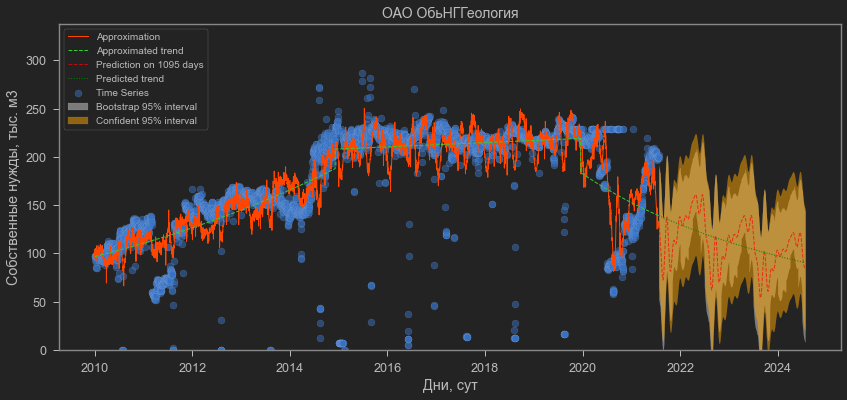

************************************************************************************************************************
The field "ОАО НГК Славнефть (Ачим.)"
Change points: [2011.8 2014.8 2017.4 2017.9]
Fourier function of 8-th order
R2=0.447; MAE=1.57 (mean_y=7.75); RMSE=3.06


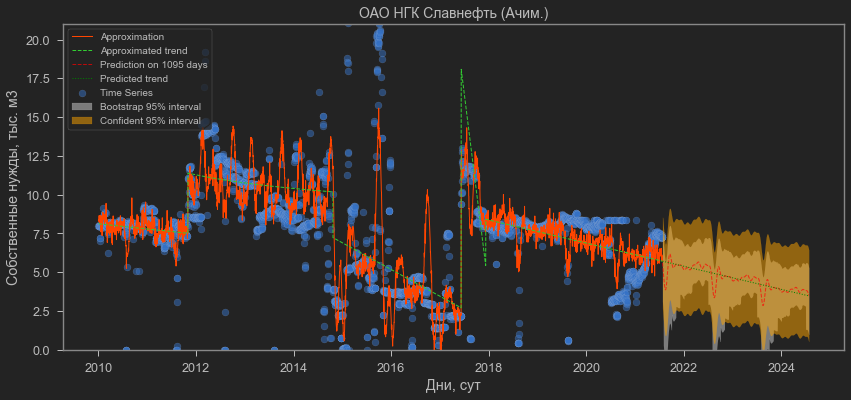

************************************************************************************************************************
The field "ООО Славнефть-Нижневарт."
Change points: [2011.9 2014.  2017.3 2020. ]
Fourier function of 8-th order
R2=0.798; MAE=10.82 (mean_y=83.52); RMSE=28.78


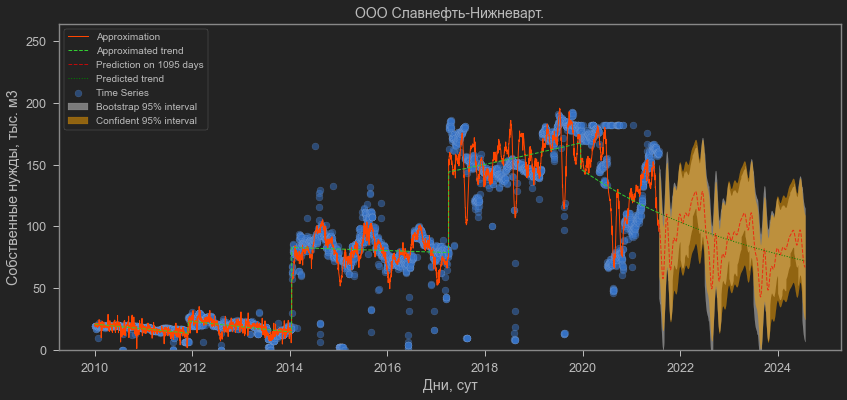

************************************************************************************************************************
The field "Западно-Салымское"
Change points: [2019.4 2020.3]
Fourier function of 8-th order
R2=0.613; MAE=17.22 (mean_y=698.74); RMSE=37.76


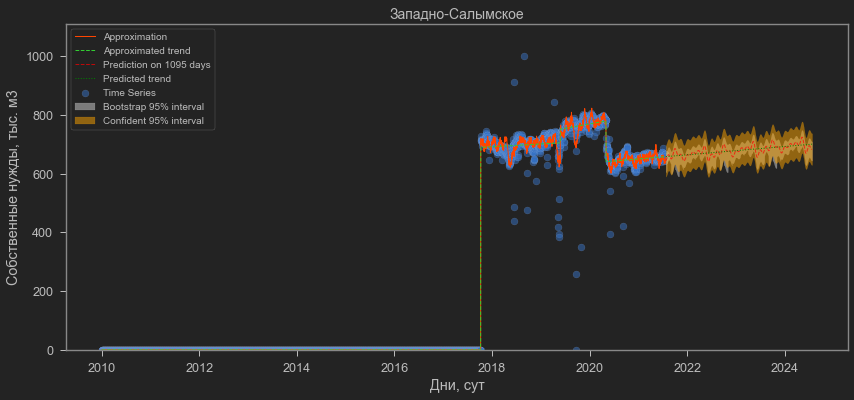

************************************************************************************************************************
The field "Оренбургское НГКМ и др"
Change points: [2018.4 2020. ]
Fourier function of 8-th order
R2=0.909; MAE=124.48 (mean_y=1498.05); RMSE=204.37


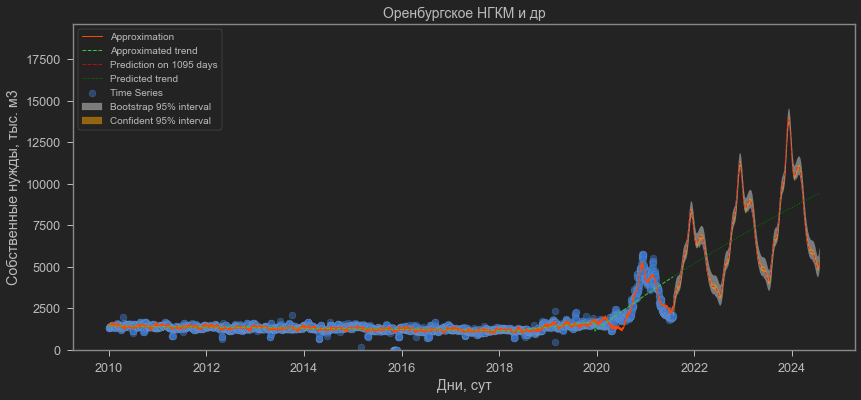

************************************************************************************************************************
The field "УНГП"
Change points: [2015.5]
Fourier function of 8-th order
R2=0.703; MAE=23.55 (mean_y=38.21); RMSE=50.08


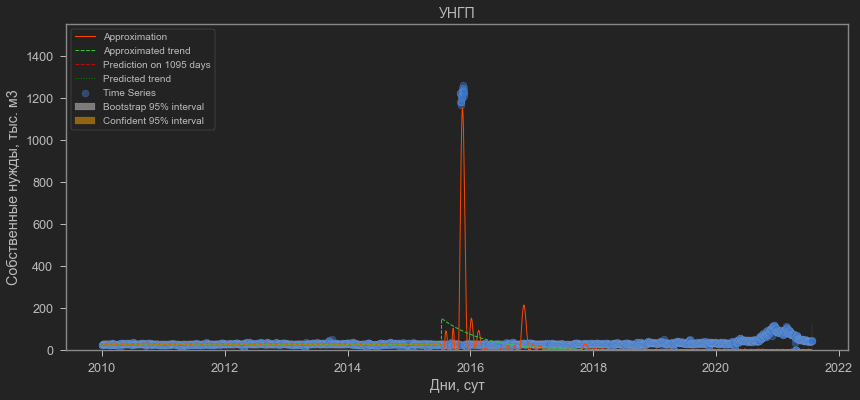

************************************************************************************************************************
The field "ООО Сервиснефтегаз"
Change points: [2015.5]
Fourier function of 8-th order
R2=0.109; MAE=0.31 (mean_y=0.49); RMSE=1.0


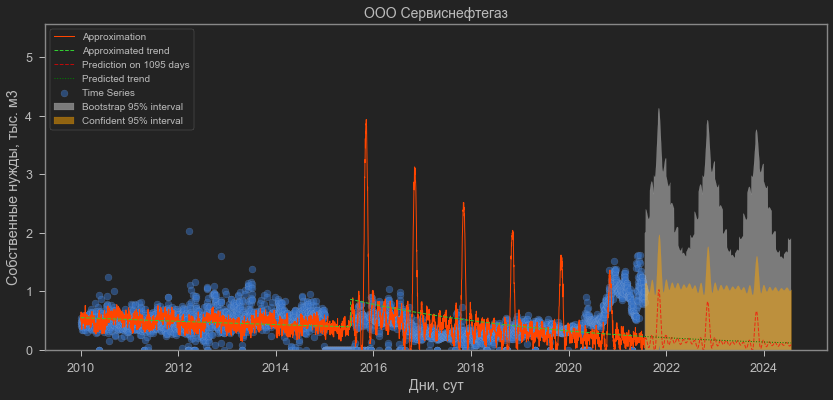

************************************************************************************************************************
The field "Kаневско-Лебяжье ГКМ"
Change points: [2017.1 2019.5]
Fourier function of 8-th order
R2=0.636; MAE=1.25 (mean_y=7.6); RMSE=1.69


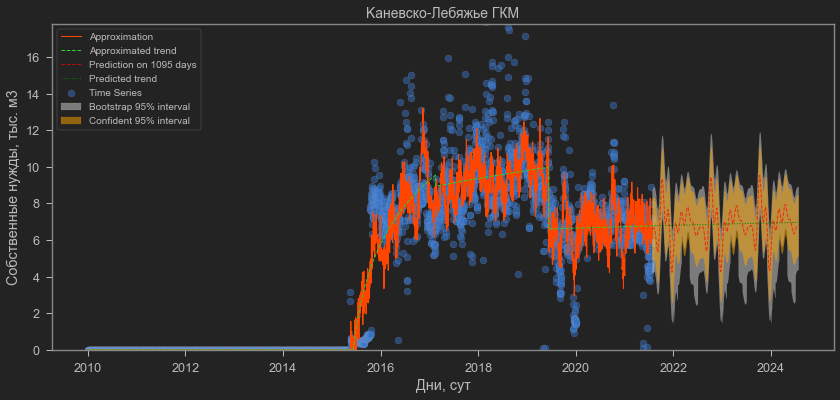

************************************************************************************************************************
The field "Челбасское ГКМ"
Change points: [2017.]
Fourier function of 8-th order
R2=0.661; MAE=0.68 (mean_y=4.95); RMSE=0.95


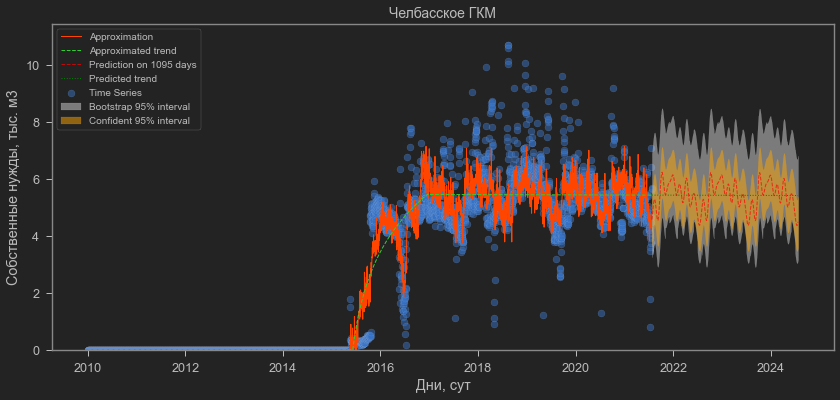

************************************************************************************************************************
The field "Бейсугское ГМ"
Change points: [2015.8 2018.8]
Fourier function of 8-th order
R2=0.853; MAE=0.99 (mean_y=7.91); RMSE=1.47


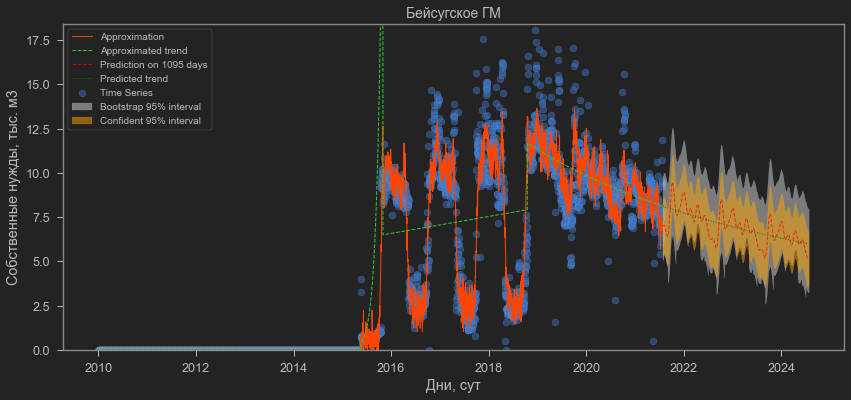

************************************************************************************************************************
The field "Роговское ГМ"
Change points: [2018.6]
Fourier function of 8-th order
R2=0.681; MAE=0.86 (mean_y=5.52); RMSE=1.13


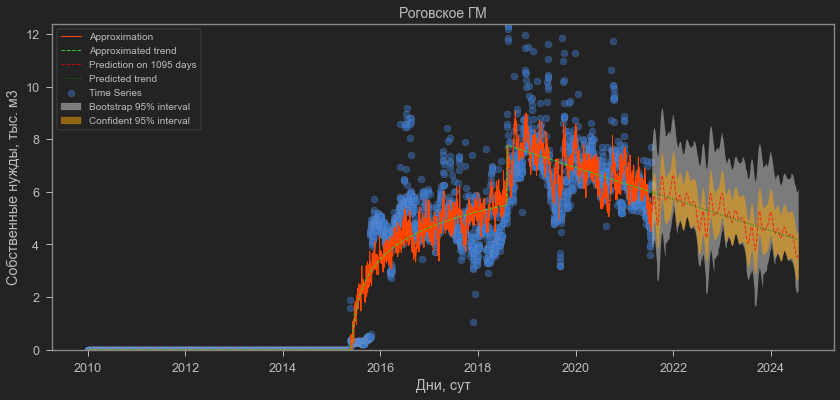

************************************************************************************************************************
The field "Гречаное ГМ"
Change points: [2016.3 2018.5 2020.8]
Fourier function of 8-th order
R2=0.881; MAE=0.19 (mean_y=0.91); RMSE=0.34


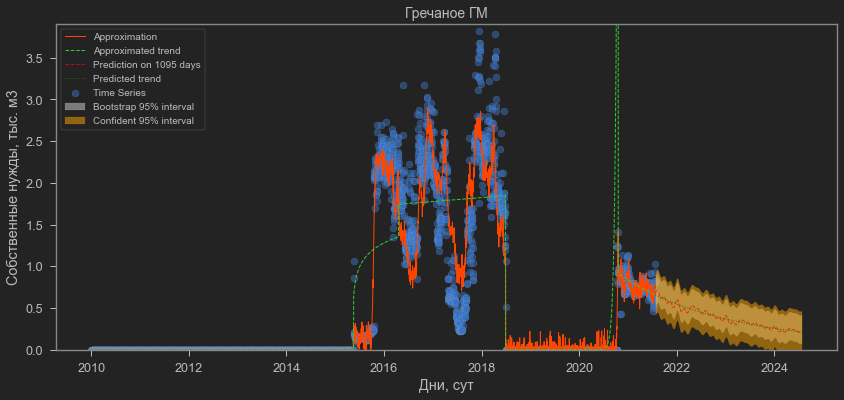

************************************************************************************************************************
The field "Граничное ГКМ"
Change points: [2016.9 2019.3]
Fourier function of 8-th order
R2=0.9; MAE=0.17 (mean_y=0.82); RMSE=0.27


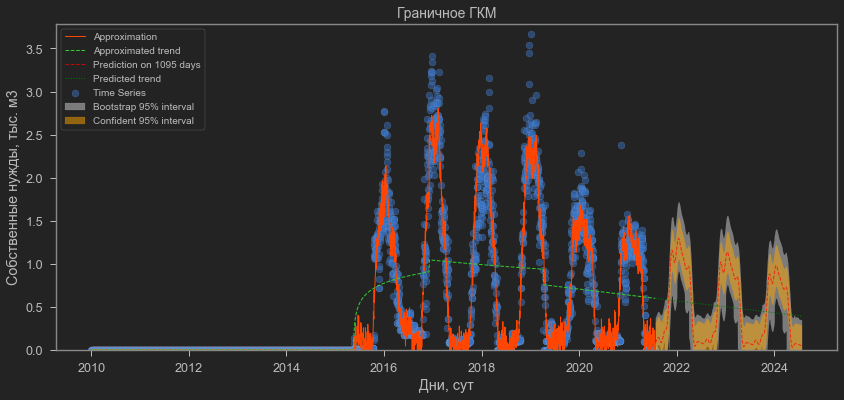

************************************************************************************************************************
The field "Синявское ГМ"
Change points: [2017.2 2019.5]
Fourier function of 8-th order
R2=0.671; MAE=0.62 (mean_y=4.6); RMSE=0.88


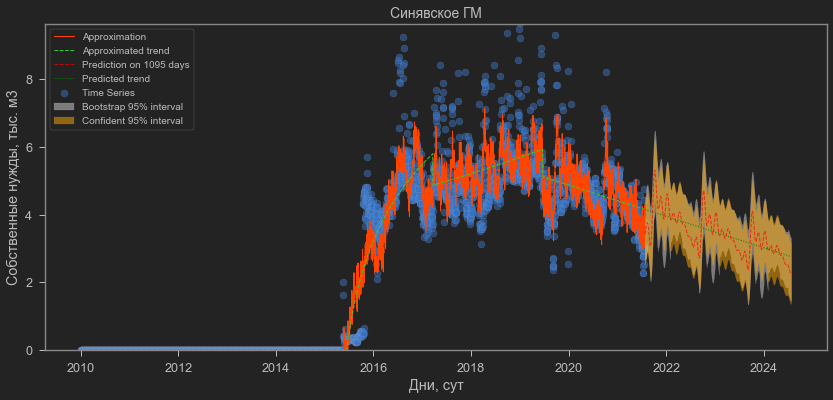

************************************************************************************************************************
The field "Азовское ГМ"
Change points: [2017.  2019.3]
Fourier function of 8-th order
R2=0.835; MAE=1.9 (mean_y=13.68); RMSE=2.59


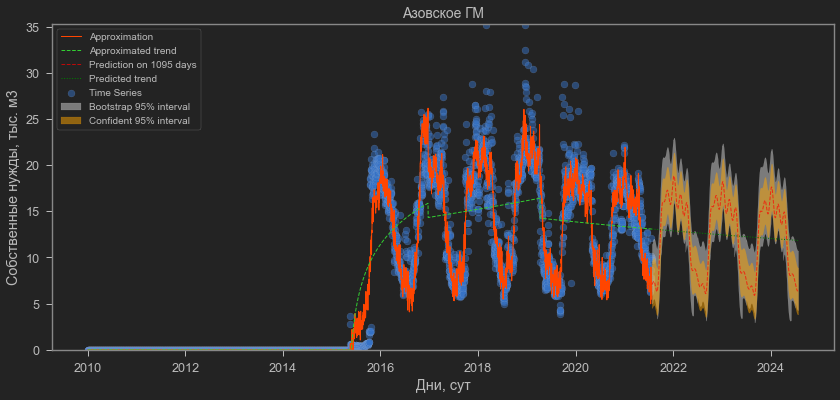

************************************************************************************************************************
The field "Патроновское ГКМ"
Change points: [2018.8 2019.3 2020.4]
Fourier function of 8-th order
R2=0.713; MAE=0.44 (mean_y=2.11); RMSE=0.6


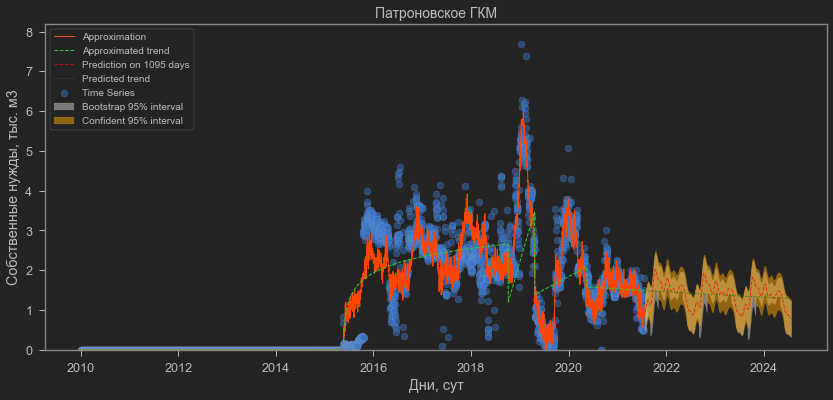

************************************************************************************************************************
The field "Марковское ГКМ"
Change points: [2019.5]
Fourier function of 8-th order
R2=0.544; MAE=6.86 (mean_y=38.49); RMSE=9.25


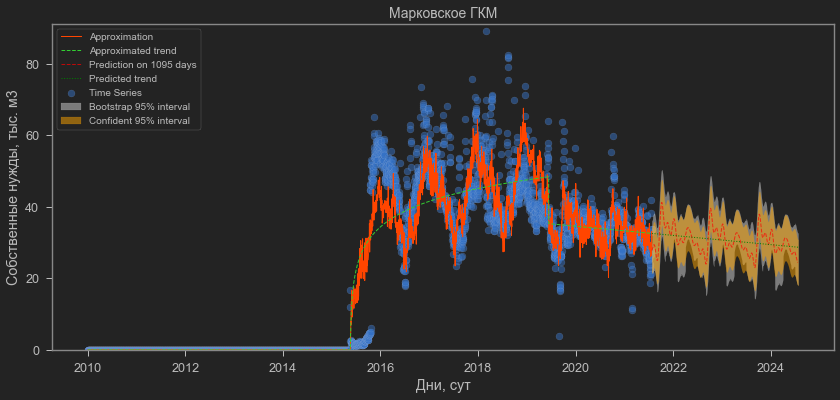

************************************************************************************************************************
The field "Элитное ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.265; MAE=0.32 (mean_y=0.75); RMSE=0.43


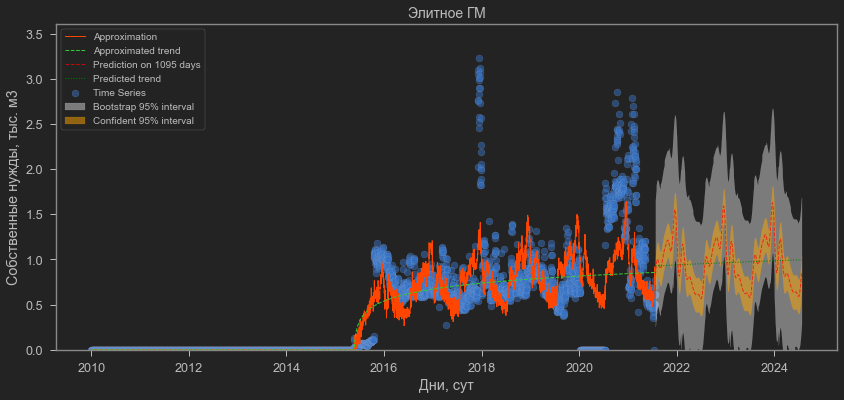

************************************************************************************************************************
The field "Зап.-Красноармейское ГМ"
Change points: [2019.5 2020.5]
Fourier function of 8-th order
Use simple approximation median
R2=0.685; MAE=0.41 (mean_y=2.19); RMSE=0.55


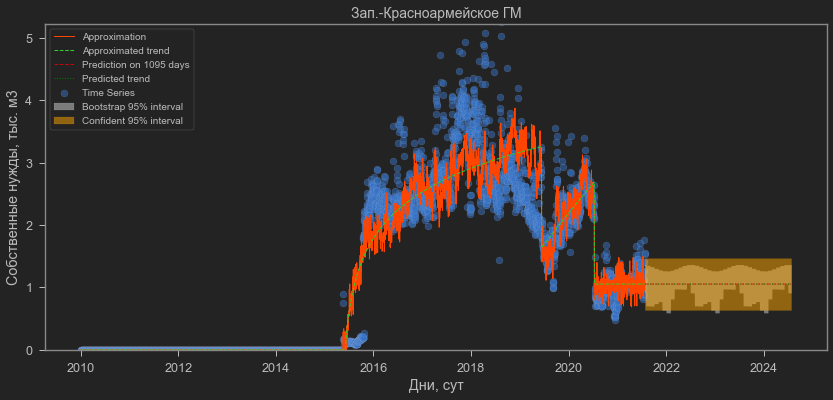

************************************************************************************************************************
The field "Красноармейское ГМ"
Change points: [2017.  2019.3]
Fourier function of 8-th order
R2=0.879; MAE=0.5 (mean_y=3.19); RMSE=0.69


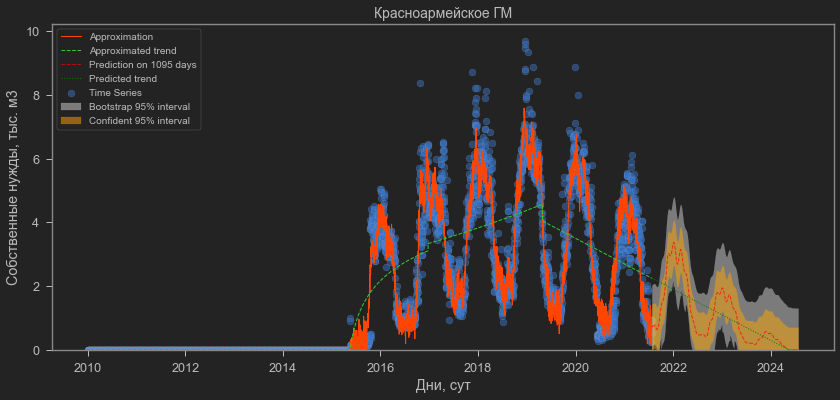

************************************************************************************************************************
The field "Сев.-Чебургольское ГМ"
Change points: [2017.]
Fourier function of 8-th order
R2=0.585; MAE=0.18 (mean_y=1.15); RMSE=0.24


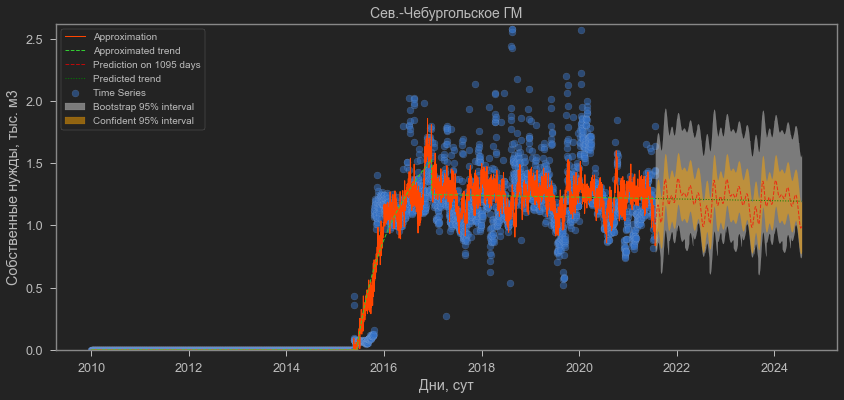

************************************************************************************************************************
The field "Гривенское ГМ"
Change points: [2019.5]
Fourier function of 8-th order
R2=0.283; MAE=1.3 (mean_y=5.71); RMSE=1.8


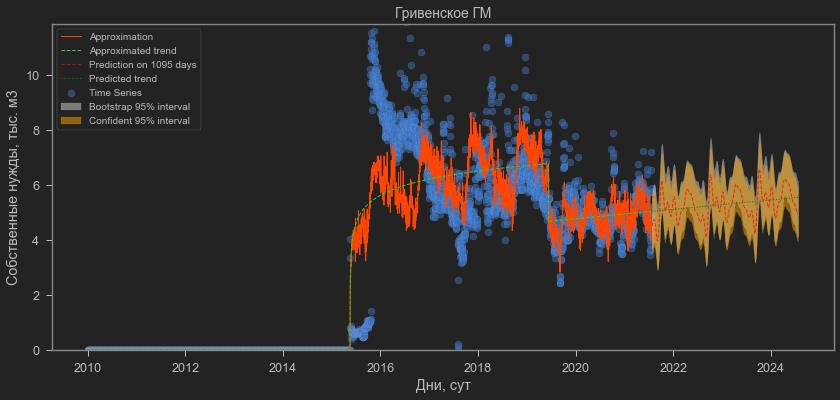

************************************************************************************************************************
The field "Сев.-Гривенское ГМ"
Change points: [2019.5]
Fourier function of 8-th order
R2=0.491; MAE=0.72 (mean_y=3.98); RMSE=0.98


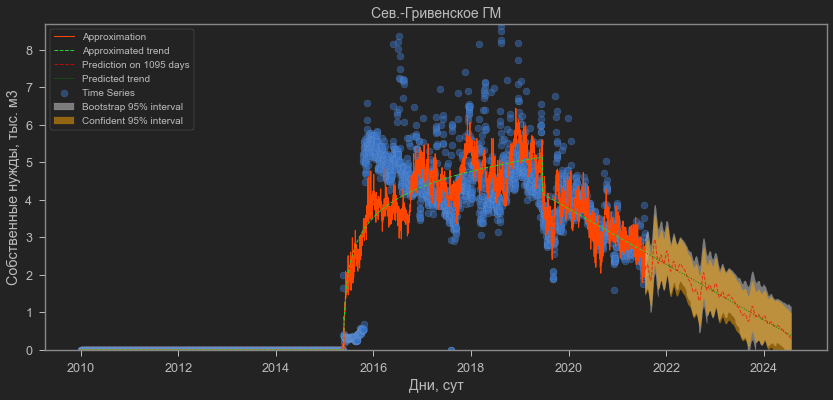

************************************************************************************************************************
The field "Мостовянское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.239; MAE=0.22 (mean_y=1.06); RMSE=0.3


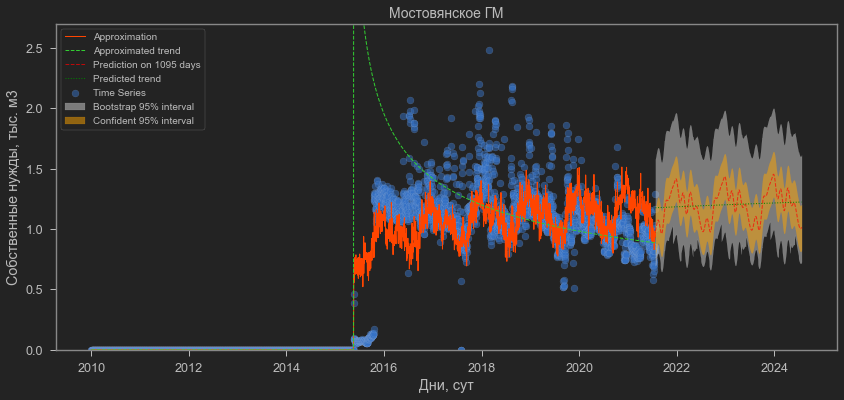

************************************************************************************************************************
The field "Мечетское ГМ"
Change points: [2017.5]
Fourier function of 8-th order
R2=0.683; MAE=0.85 (mean_y=4.41); RMSE=1.16


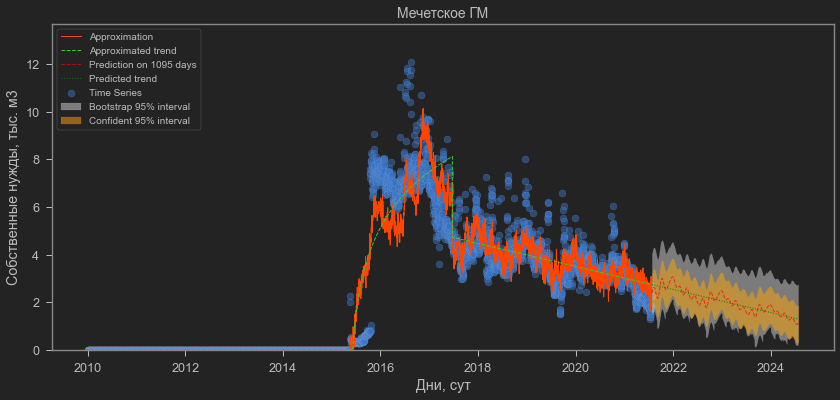

************************************************************************************************************************
The field "Майкопское ГКМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.145; MAE=0.26 (mean_y=0.97); RMSE=0.38


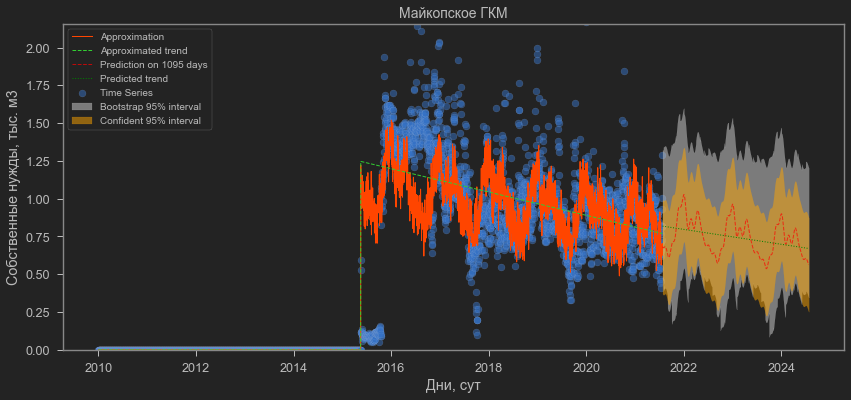

************************************************************************************************************************
The field "Прибрежное НГКМ"
Change points: [2018.1]
Fourier function of 8-th order
R2=0.523; MAE=0.83 (mean_y=2.53); RMSE=1.12


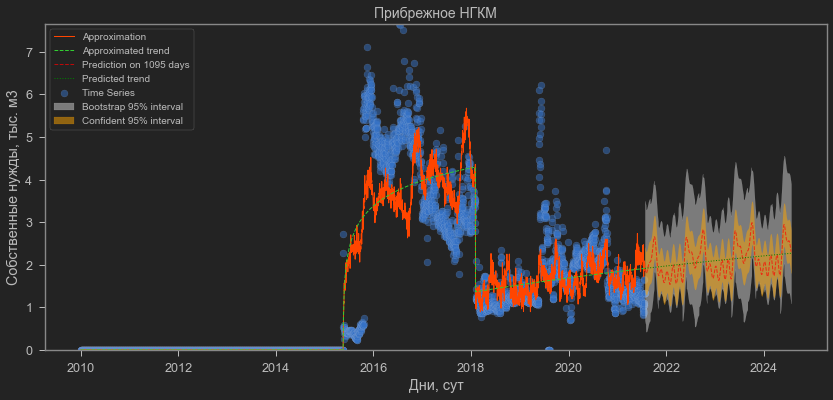

************************************************************************************************************************
The field "Вост.-Прибрежное НГКМ"
Change points: [2019.5]
Fourier function of 8-th order
R2=0.54; MAE=1.94 (mean_y=9.8); RMSE=2.58


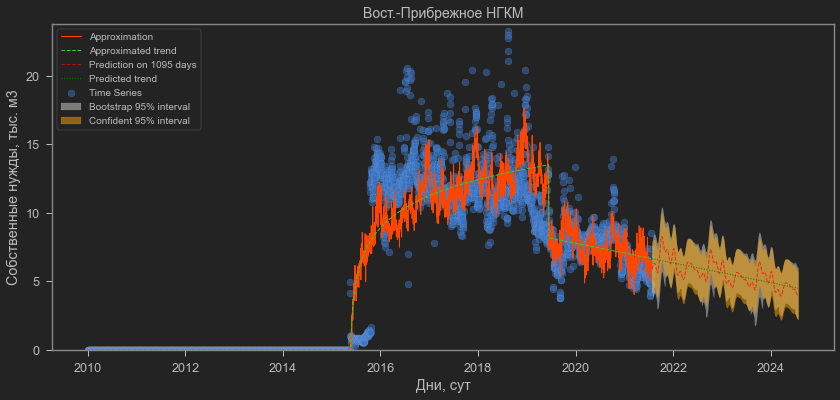

************************************************************************************************************************
The field "Сев.-Прибрежное НГКМ"
Change points: [2019.3]
Fourier function of 8-th order
R2=0.413; MAE=0.08 (mean_y=0.28); RMSE=0.11


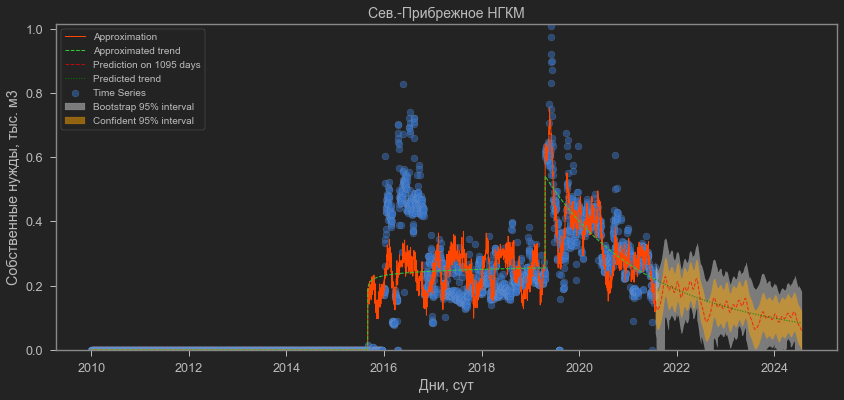

************************************************************************************************************************
The field "Ю.Черноерковск.НГКМ"
Change points: [2019.7]
Fourier function of 8-th order
R2=0.212; MAE=0.08 (mean_y=0.06); RMSE=0.14


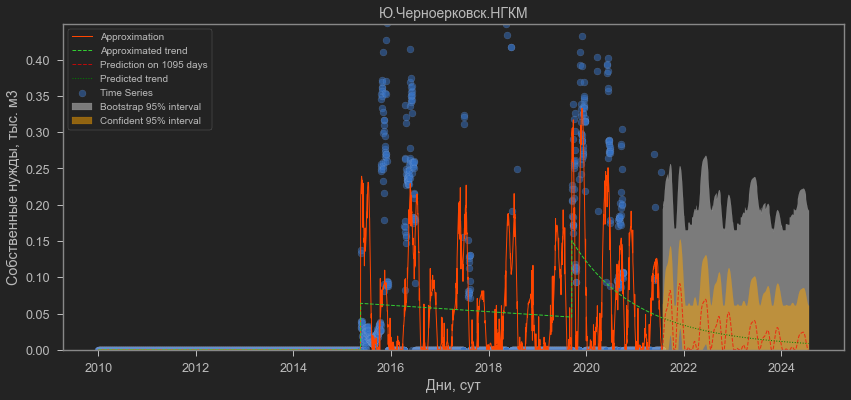

************************************************************************************************************************
The field "Мирненское ГКМ"
Change points: [2020.]
Fourier function of 8-th order
R2=0.544; MAE=0.99 (mean_y=6.07); RMSE=1.33


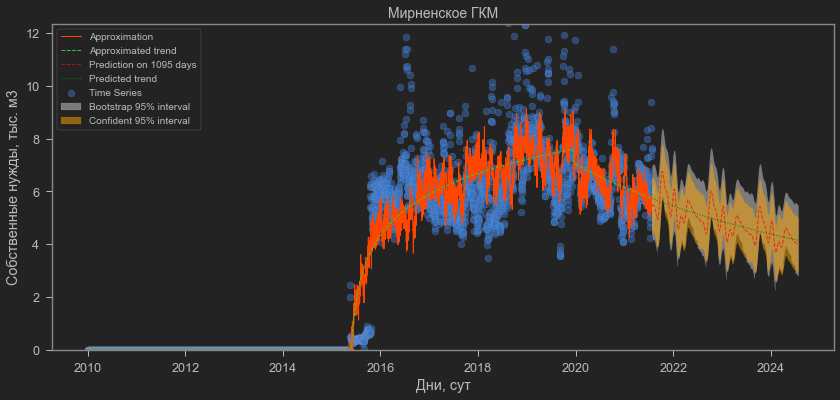

************************************************************************************************************************
The field "Журавское ГМ"
Change points: [2017.2]
Fourier function of 8-th order
R2=0.433; MAE=0.08 (mean_y=0.27); RMSE=0.11


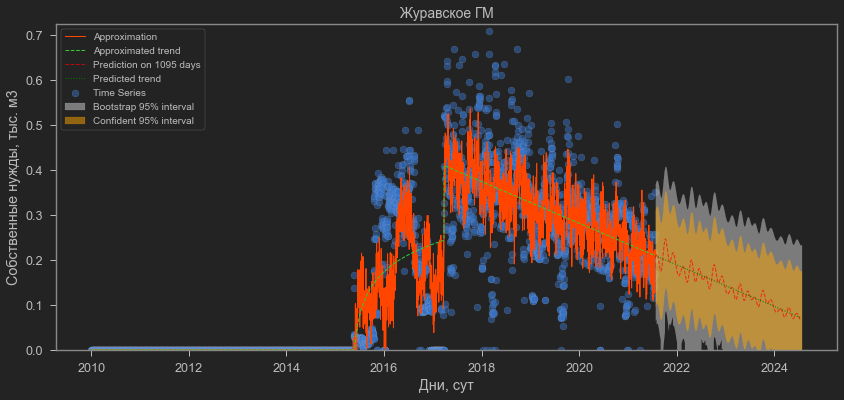

************************************************************************************************************************
The field "Каменно-Балковское ГМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.716; MAE=0.41 (mean_y=3.38); RMSE=0.59


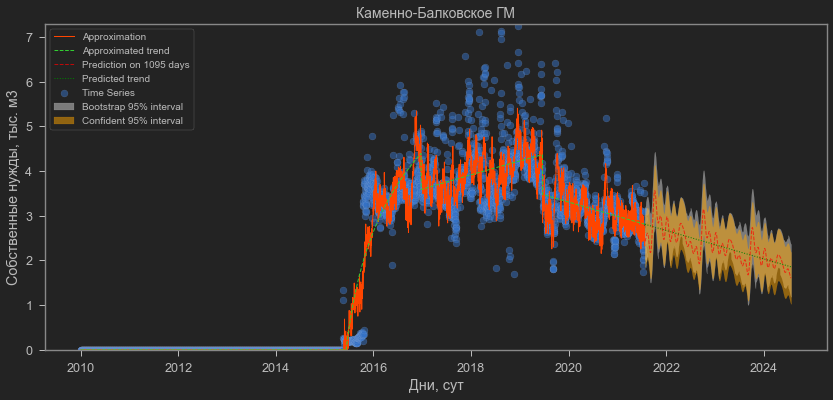

************************************************************************************************************************
The field "Петр.-Благодар.ГМ"
Change points: [2017.  2019.3]
Fourier function of 8-th order
R2=0.652; MAE=1.5 (mean_y=10.67); RMSE=2.08


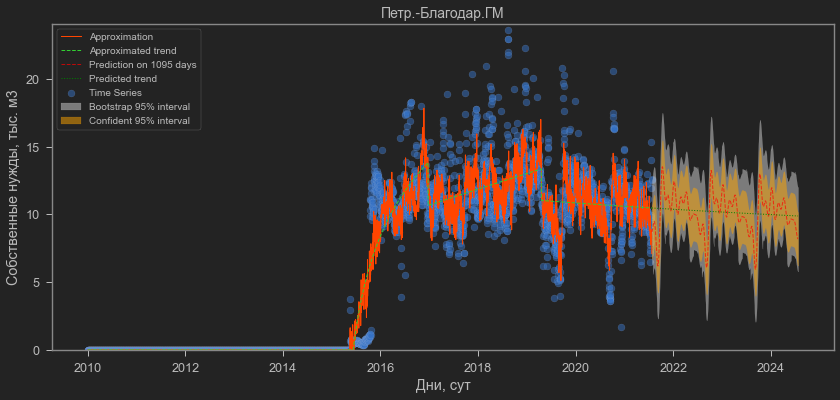

************************************************************************************************************************
The field "Кугутское ГМ"
Change points: [2017.7]
Fourier function of 8-th order
R2=0.629; MAE=0.67 (mean_y=3.44); RMSE=0.85


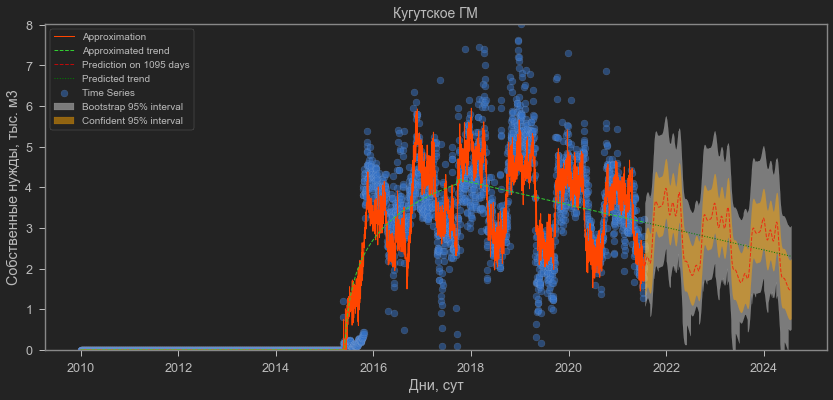

************************************************************************************************************************
The field "Безопасненское ГМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.607; MAE=0.12 (mean_y=0.77); RMSE=0.16


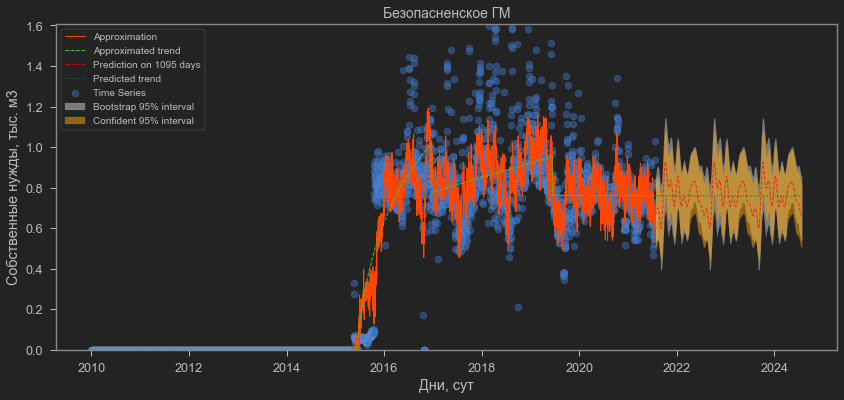

************************************************************************************************************************
The field "Тахта-Кугультинское ГМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.685; MAE=2.12 (mean_y=16.62); RMSE=2.99


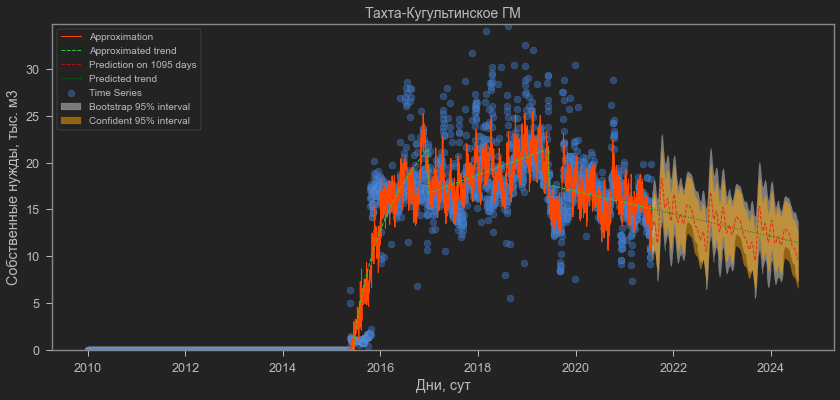

************************************************************************************************************************
The field "Радыковское ГМ"
Change points: [2017.  2018.6]
Fourier function of 8-th order
R2=0.715; MAE=0.17 (mean_y=1.27); RMSE=0.23


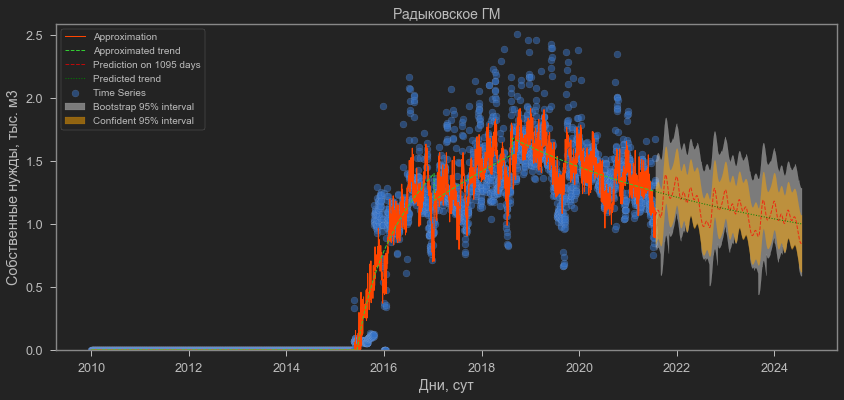

************************************************************************************************************************
The field "Южно-Радыковское ГМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.636; MAE=0.11 (mean_y=0.7); RMSE=0.15


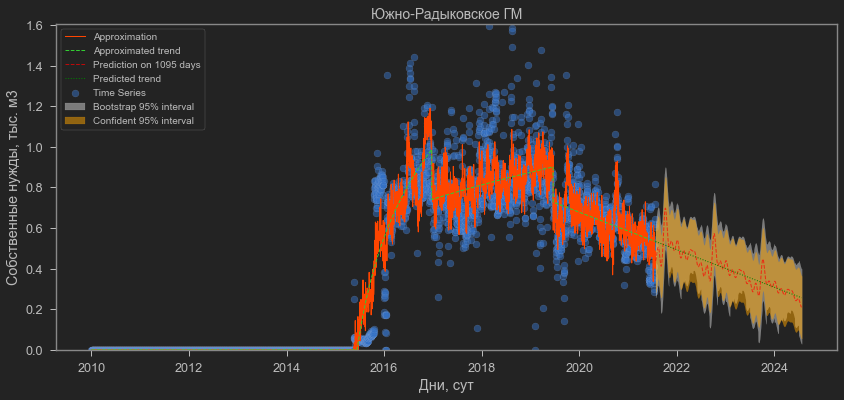

************************************************************************************************************************
The field "Сенгелеевское ГМ"
Change points: [nan]
Fourier function of 8-th order
R2=0.661; MAE=0.35 (mean_y=0.95); RMSE=0.58


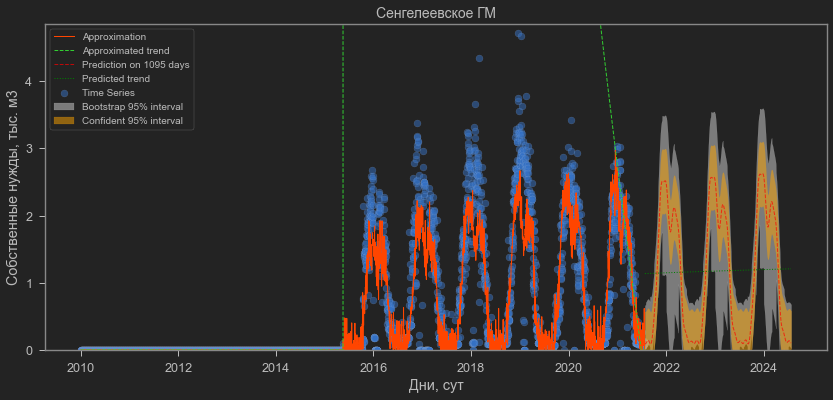

************************************************************************************************************************
The field "Расшеватское ГКМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.672; MAE=0.59 (mean_y=4.35); RMSE=0.83


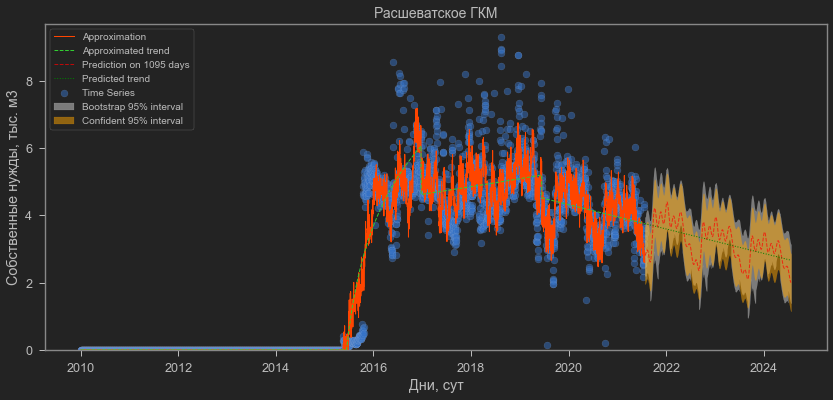

************************************************************************************************************************
The field "Николаевское ГКМ"
Change points: [2017.  2019.5]
Fourier function of 8-th order
R2=0.712; MAE=0.43 (mean_y=3.61); RMSE=0.6


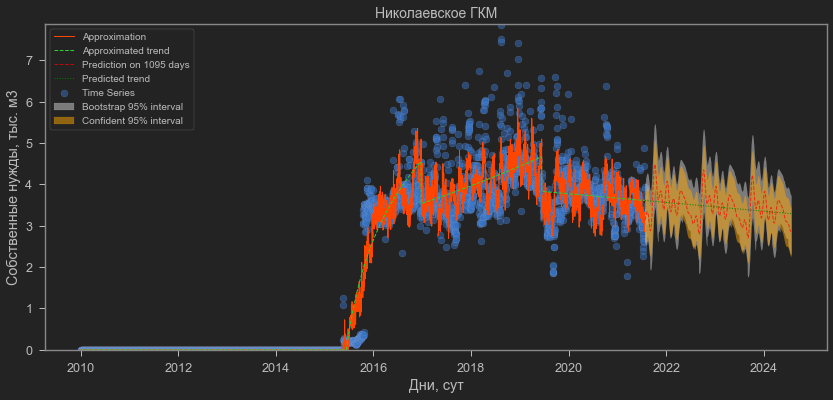

************************************************************************************************************************
The field "Ильинское ГКМ"
Change points: [2017.  2019.6]
Fourier function of 8-th order
R2=0.746; MAE=0.13 (mean_y=1.1); RMSE=0.19


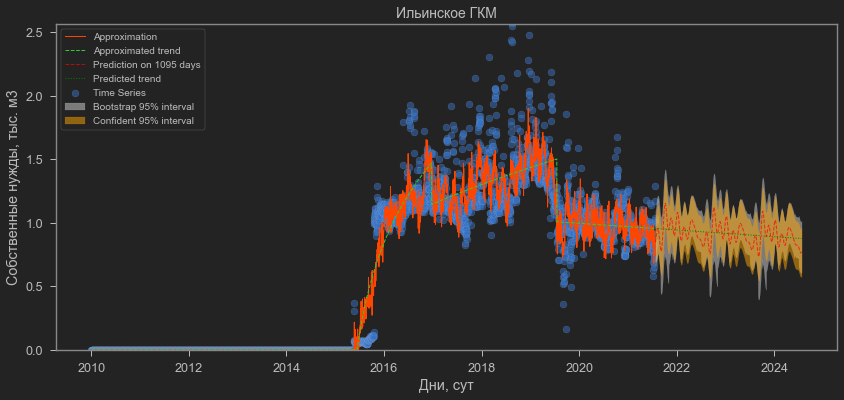

************************************************************************************************************************
The field "Вуктыльское"
Change points: [2012.8 2015.8]
Fourier function of 8-th order
R2=0.937; MAE=30.61 (mean_y=266.17); RMSE=52.9


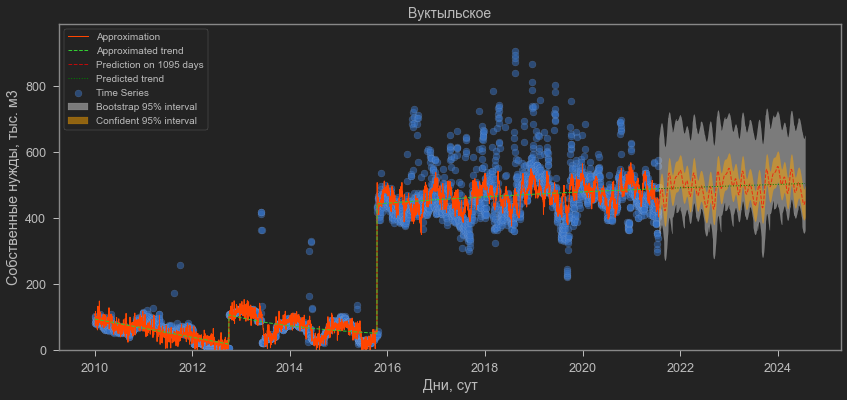

************************************************************************************************************************
The field "Зап.Соплесское"
Change points: [2012.8 2015.8 2017.7 2019.5]
Fourier function of 8-th order
R2=0.933; MAE=1.38 (mean_y=11.09); RMSE=2.24


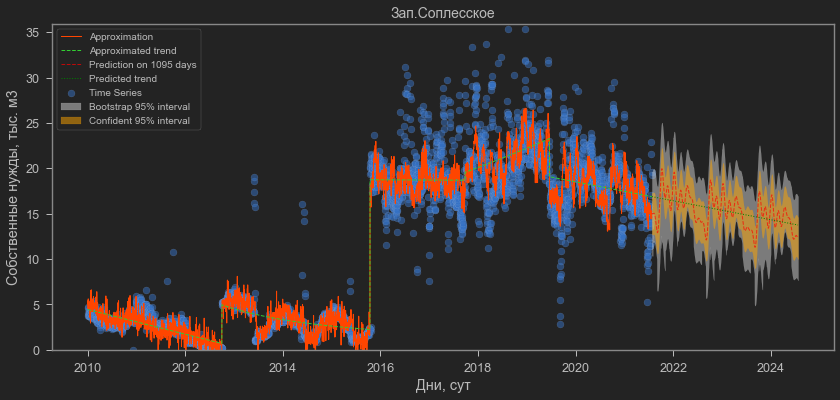

************************************************************************************************************************
The field "Югидское"
Change points: [2015.8]
Fourier function of 8-th order
R2=0.875; MAE=1.88 (mean_y=13.12); RMSE=2.89


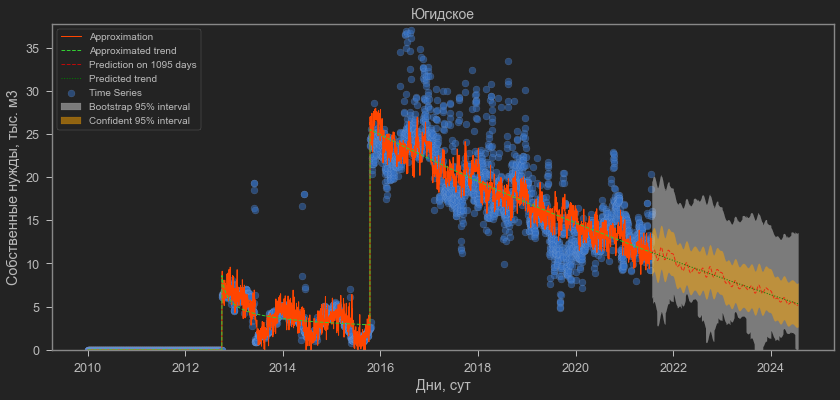

************************************************************************************************************************
The field "Печерокожвинское"
Change points: [2015.8 2017.7 2020. ]
Fourier function of 8-th order
R2=0.924; MAE=1.79 (mean_y=16.56); RMSE=2.87


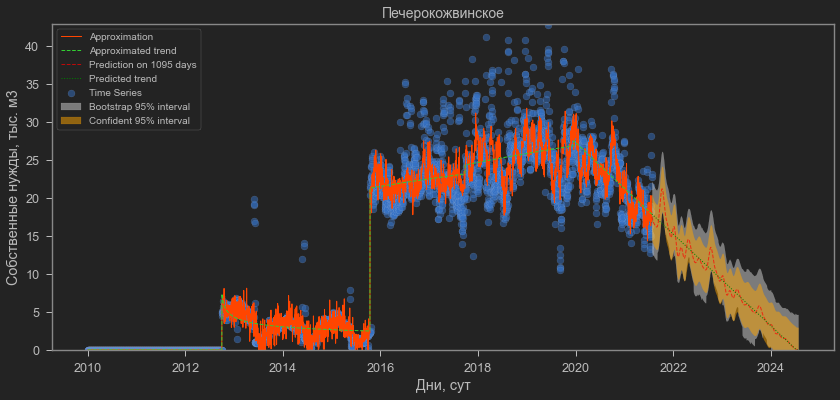

************************************************************************************************************************
The field "ЗАО ПечораНГП"
Change points: [nan]
Fourier function of 8-th order
R2=1.0; MAE=0.0 (mean_y=0.0); RMSE=0.0


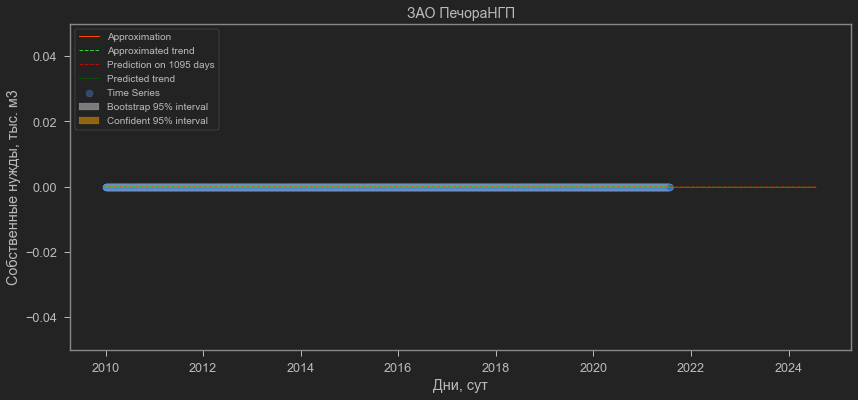

************************************************************************************************************************
The field "Добыча газа (ГПН)"
Change points: [2017.6]
Fourier function of 8-th order
R2=0.922; MAE=408.21 (mean_y=2600.59); RMSE=724.53


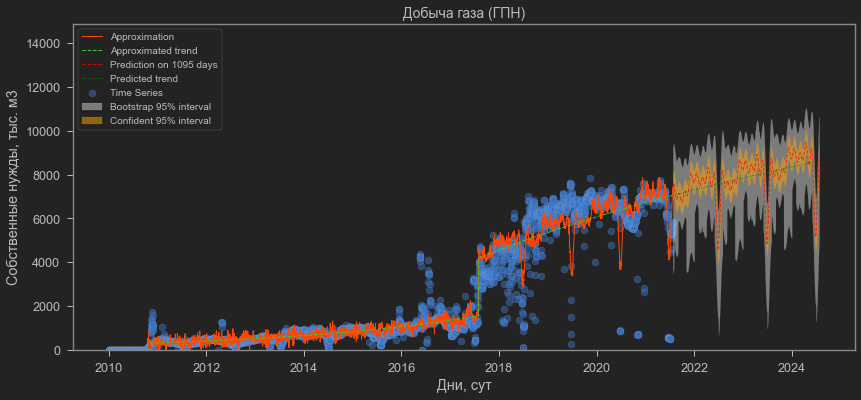

************************************************************************************************************************
The field "Попутный газ (ГПН)"
Change points: [2018.5]
Fourier function of 8-th order
R2=0.967; MAE=888.97 (mean_y=6413.41); RMSE=1480.75


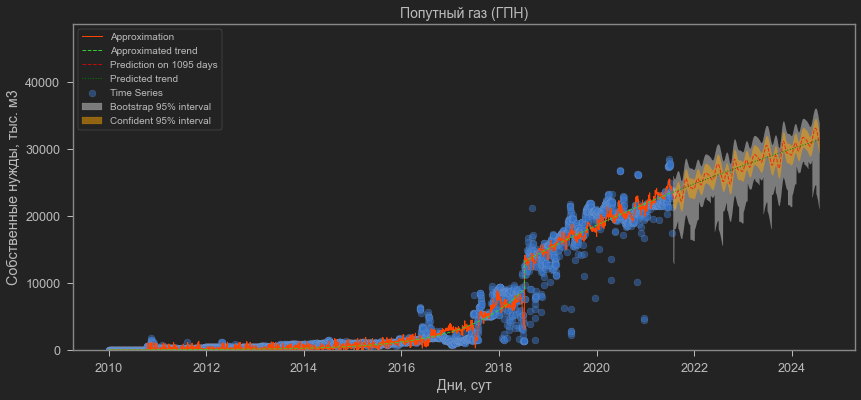

In [16]:
result = pd.DataFrame()
prediction = 365*3
for field in fields_for_sum:
    _result = time_series_approximation(df, field, fourier_order=8, noise_alpha=0.05, noise_window=5, prediction=prediction, exceptions=exceptions, 
                                        target_col='Собственные нужды')
    _result['Месторождение'] = field
    result = pd.concat((result, _result), axis=0)

In [17]:
full_result = pd.merge(result, df[['Дата', 'Месторождение', 'Собственные нужды']], how='left', on=['Месторождение', 'Дата'])
full_result['Residuals'] = full_result['Approximation'] - full_result['Собственные нужды']
full_result['Series_Var'] = full_result['Series_STD'] ** 2

# Save approximation result
full_result.to_csv("consumption_result.csv")

In [17]:
result.head()

,Дата,Month,Approximation,Trend,Series_STD,Series_T-stat_0.95,Single_Noise,Bootstrap_quantile_0.025,Bootstrap_quantile_0.975,Месторождение
0,2010-01-01,1,3414.124924,3665.758434,42.992154,1.960526,-5.401323,-115.597575,155.68288,Заполярное
1,2010-01-02,1,3411.809078,3478.333411,42.992154,1.960526,-14.649213,-115.597575,155.68288,Заполярное
2,2010-01-03,1,3409.841655,3397.701547,42.992154,1.960526,-59.039082,-115.597575,155.68288,Заполярное
3,2010-01-04,1,3408.288856,3346.133671,42.992154,1.960526,42.687702,-115.597575,155.68288,Заполярное
4,2010-01-05,1,3407.205931,3308.308449,42.992154,1.960526,-3.551746,-115.597575,155.68288,Заполярное


-------

### Суммирование ошибок

In [132]:
df_sum = result.groupby('Дата').agg(Approximation=('Approximation', np.sum)).reset_index()
df_sum = pd.merge(df_sum, 
                  df.loc[np.isin(df['Месторождение'], fields_for_sum), ['Дата', 'Добыча', 'Месторождение']].groupby('Дата').agg(Добыча=('Добыча', np.sum)),
                  how='left', on='Дата')
df_sum.head()

,Дата,Approximation,Добыча
0,2010-01-01,1.555004e+06,1550582.66
1,2010-01-02,1.555447e+06,1556934.19
2,2010-01-03,1.554683e+06,1548875.29
3,2010-01-04,1.554008e+06,1552038.31
4,2010-01-05,1.553522e+06,1554068.51


In [133]:
def distr_reduction(input_array, items=1000, bins=100):
    hist, bin_edges = np.histogram(input_array, bins=bins, density=True)
#     return np.random.choice((bin_edges[1:] - np.diff(bin_edges) / 2), p=(hist * np.diff(bin_edges)), size=items)
    return np.random.choice(np.linspace(bin_edges[0], bin_edges[-1], bins), p=(hist * np.diff(bin_edges)), size=items)

def skewed_distribution_summarizer(df, items=1000, bins=100):
    skewed_distribution_data = pd.DataFrame()
    for month in range(11, 12):
#         month_data = df.loc[df['Month'] == month + 1, ['Дата', 'Месторождение', 'Approximation', 'Добыча', 'Residuals']].dropna()
        month_data = df.loc[:, ['Дата', 'Месторождение', 'Approximation', 'Добыча', 'Residuals']].dropna()
        fields = month_data['Месторождение'].unique()
        total_residuals = []
        for k in range(len(fields)):
            print('*' * 50)
            print(f'Month: {month + 1}; Field: {k}. {fields[k]}')
            if len(total_residuals) == 0:
                total_residuals = distr_reduction(month_data.loc[month_data['Месторождение'] == fields[k], 'Residuals'].values, items=items, bins=bins)
            else:
                total_residuals = distr_reduction(_total_residuals, items=items, bins=bins)
            for t in range(k+1, len(fields)):
                _total_residuals = []
                for j in total_residuals:
                    for i in distr_reduction(month_data.loc[month_data['Месторождение'] == fields[t], 'Residuals'].values, items=items, bins=bins):
                        _total_residuals.append(j + i)
        skewed_distribution_data = pd.concat((skewed_distribution_data, pd.DataFrame(data={'Month': [month+1 for _ in range(len(total_residuals))],
                                                                                           'Residuals': total_residuals})), axis=0)
        
    return skewed_distribution_data

In [189]:
full_result = pd.merge(result ,df[['Дата', 'Месторождение', 'Добыча']], how='left', on=['Месторождение', 'Дата'])
full_result['Residuals'] = full_result['Approximation'] - full_result['Добыча']
full_result['Series_Var'] = full_result['Series_STD']**2
full_result = full_result.drop(columns=['Series_STD', 'Single_Noise', 'Bootstrap_quantile_0.025', 'Bootstrap_quantile_0.975'])
sum_data = full_result.groupby('Дата').agg(Approximation=('Approximation', np.sum),
                                           Trend=('Trend', np.sum),
                                           Series_Tstat=('Series_T-stat_0.95', np.mean),
                                           Series_Var=('Series_Var', np.sum),
                                           Month=('Month', np.mean)).reset_index()
sum_data.rename(columns={'Series_Tstat': 'Series_T-stat_0.95'}, inplace=True)

In [ ]:
# %%time
# skewed_distribution_data = skewed_distribution_summarizer(full_result, items=1000, bins=100)

**************************************************
Month: 12; Field: 0. Заполярное
**************************************************
Month: 12; Field: 1. Тазовское (МНГ)
**************************************************
Month: 12; Field: 2. Ямбургское
**************************************************
Month: 12; Field: 3. Бованенковское
**************************************************
Month: 12; Field: 4. Медвежье (сеном)
**************************************************
Month: 12; Field: 5. УКПГ-НТС
**************************************************
Month: 12; Field: 6. УКПГ-Ныда
**************************************************
Month: 12; Field: 7. Харасавэйское
**************************************************
Month: 12; Field: 8. Юбилейное (сеном)
**************************************************
Month: 12; Field: 9. Ямсовейское
**************************************************
Month: 12; Field: 10. Вынгапуровское
**************************************************
Month: 1

In [16]:
#  skewed_distribution_data.to_csv("monthly_residuals.csv")

In [135]:
skewed_distribution_data = pd.read_csv("monthly_residuals.csv")

In [148]:
from Calculation_funcs import variation
from Supporting_inform_funcs import ts_graphic

In [205]:
df_sum['Month'] = df_sum['Дата'].dt.month
noise = pd.DataFrame(data={'Month': df_sum['Дата'][:-prediction].dt.month, 
                           'Residuals':df_sum['Добыча'][:-prediction].values - sum_data['Approximation'][:-prediction].values})
sum_data = variation(df_sum, noise, alpha=alpha, bootstrap=False)

In [209]:
alpha = 0.05

noise_of_total_series = pd.DataFrame(data={'Month': df_sum['Дата'][:-prediction].dt.month, 
                                           'Residuals': df_sum['Добыча'][:-prediction].values - uniform_filter1d(df_sum['Добыча'][:-prediction].values, size=7)})
sum_data = variation(sum_data, noise_of_total_series, alpha=0, bootstrap=False)
sum_data = variation(sum_data, skewed_distribution_data, alpha=alpha, bootstrap=True)
sum_data.head()

,Дата,Approximation,Добыча,Month,Series_STD,Series_T-stat_0.95,Series_T-stat_1,Bootstrap_quantile_0.025,Bootstrap_quantile_0.975
0,2010-01-01,1.555004e+06,1550582.66,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262
1,2010-01-02,1.555447e+06,1556934.19,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262
2,2010-01-03,1.554683e+06,1548875.29,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262
3,2010-01-04,1.554008e+06,1552038.31,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262
4,2010-01-05,1.553522e+06,1554068.51,1,37499.89242,1.966362,NaN,-64081.956964,50128.30262


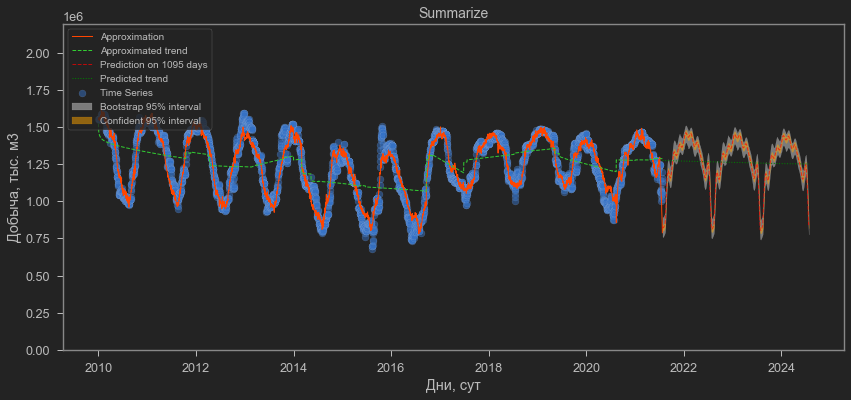

In [138]:
ts_graphic(df_sum['Добыча'][:-prediction].values, sum_data, field='Summarize', date_col='Дата', target_col='Добыча', days_col='Дни', prediction=prediction)

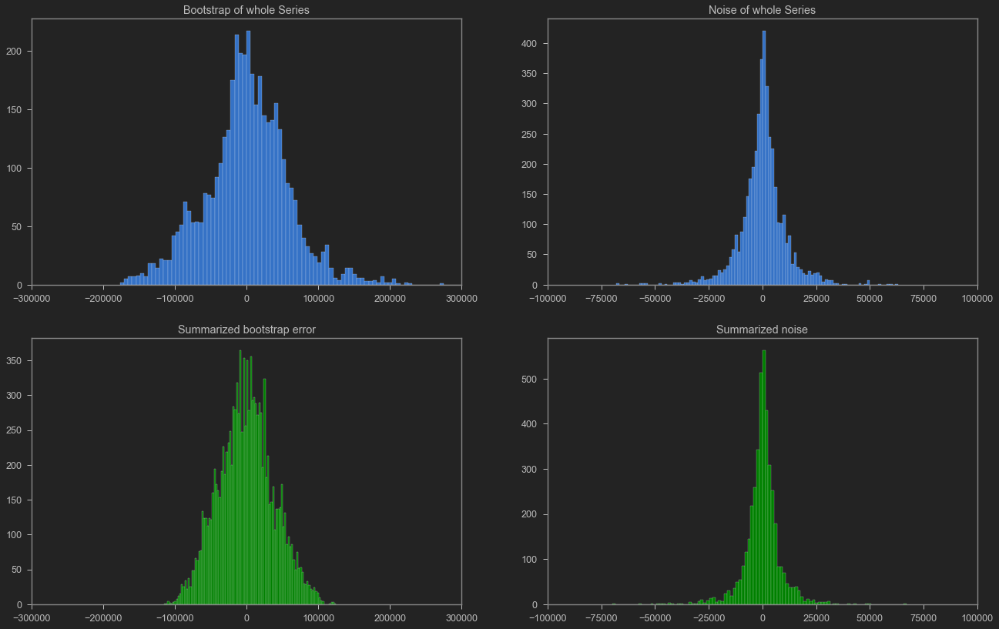

In [139]:
plt.figure(figsize=(22,14))

plt.subplot(221)
plt.hist(df_sum['Добыча'][:-prediction].values - sum_data['Approximation'][:-prediction].values, bins=100, edgecolor='white')
plt.xlim(-300000, 300000)
plt.title('Bootstrap of whole Series')

plt.subplot(222)
plt.hist(sum_data['Single_Noise'][:-prediction].values, bins=100, edgecolor='white')
plt.xlim(-100000, 100000)
plt.title('Noise of whole Series')

plt.subplot(223)
plt.hist(skewed_distribution_data['Residuals'].values, bins=100, edgecolor='white', color='green')
plt.xlim(-300000, 300000)
plt.title('Summarized bootstrap error')

plt.subplot(224)
plt.hist(noise, bins=100, edgecolor='white', color='green')
plt.xlim(-100000, 100000)
plt.title('Summarized noise')

plt.show()